# Годовой проект - Определение популярности геолокации для размещения банкомата

`Куратор`:
- Ковалева Александра  
    
`Команда`:
- Цуканов Николай Сергеевич
- Исхаков Ильдус Халитович
- Устименко Кирилл Александрович
- Волокитина Анастасия Евгеньевна

## Исходные данные

`id` - идентификатор банкомата  
`atm_group` - принадлежность банкомата к группе  
`address` - адрес банкомата на английском  
`address_rus` - адрес банкомата на русском  
`lat` - широта  
`long` - долгота    
`target` - целевая метрика  

Импортируем библиотеки:

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import re

Загрузим данные:

In [2]:
df_train = pd.read_csv('train.csv', index_col=0)
df_test = pd.read_csv('test.csv', index_col=0)

In [3]:
train_rows, train_columns = df_train.shape
test_rows, test_columns = df_test.shape
print(f'Данные для обучающей выборки состоят из {train_rows} строки и {train_columns} столбцов.')
print(f'Данные для тестовой выборки состоят из {test_rows} строк и {test_columns} столбцов.')

Данные для обучающей выборки состоят из 6261 строки и 7 столбцов.
Данные для тестовой выборки состоят из 2504 строк и 6 столбцов.


Посмотрим на наши наблюдения:

In [4]:
df_train.sample(5)

,id,atm_group,address,address_rus,lat,long,target
1543,801.0,1942.0,2J VYSOTNAYA STR. KRASNOYARSK,"Высотная улица, 2, Красноярск, Россия, 660062",56.024783,92.784506,0.039432
4511,6364.0,5478.0,"D. 45, PR-KT MIRA UST-ILIMSK G","проспект Мира, 45, Усть-Илимск, Иркутская обла...",57.940211,102.733294,0.029020
3971,598.0,1942.0,131 BELORUSSKAYA STR. SAMARA,"Белорусская улица, 131, посёлок Сухая Самарка,...",53.142627,50.041542,0.037456
3051,4972.0,5478.0,"D. 51B, UL. KIROVA BATAYSK G","улица Кирова, 51Д, Батайск, Ростовская область...",47.136734,39.743103,-0.076574
882,7283.0,5478.0,"D. 2, SH. BERDSKOE NOVOSIBIRSK","Бердское шоссе, 2, Новосибирск, Россия, 630097",54.970200,83.037336,-0.011463


## __Часть 1 | EDA и визуализация__

__1. Посмотрим на типы данных:__

In [5]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 6261 entries, 0 to 6260
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           6261 non-null   float64
 1   atm_group    6261 non-null   float64
 2   address      6261 non-null   object 
 3   address_rus  5957 non-null   object 
 4   lat          5957 non-null   float64
 5   long         5957 non-null   float64
 6   target       6261 non-null   float64
dtypes: float64(5), object(2)
memory usage: 391.3+ KB


__2. Посмотрим на наличие пропусков:__

In [6]:
df_train.isna().sum()

,0
id,0
atm_group,0
address,0
address_rus,304
lat,304
long,304
target,0


In [7]:
data_gaps = round(100 * df_train[df_train['address_rus'].isna()].shape[0] / df_train.shape[0], 2)

In [8]:
print(f'Имеется 304 банкомата ({data_gaps}% от общего числа) без указания адреса на русском и географических координат.')

Имеется 304 банкомата (4.86% от общего числа) без указания адреса на русском и географических координат.


__3. Посмотрим на наличие полных дублей:__

In [9]:
df_train.duplicated().sum()

np.int64(0)

Дубли отсутствуют.

__4. Посмотрим на описательные статистики:__

Посмотрим на количественные переменные:

In [10]:
pd.options.display.float_format = '{:,.2f}'.format

In [11]:
df_train.describe(include='number')

,id,atm_group,lat,long,target
count,"6,261.00","6,261.00","5,957.00","5,957.00","6,261.00"
mean,"4,419.12","4,417.94",54.16,63.52,0.00
std,"2,547.21","2,430.41",4.35,33.02,0.09
min,5.00,32.00,42.06,19.94,-0.15
25%,"2,228.00","1,942.00",52.25,37.86,-0.06
50%,"4,392.00","5,478.00",55.07,48.58,-0.02
75%,"6,660.00","5,478.00",56.12,84.95,0.04
max,"8,811.00","8,083.00",69.49,173.71,0.22


In [12]:
df_test.describe(include='number')

,id,atm_group,lat,long
count,"2,504.00","2,504.00","2,388.00","2,388.00"
mean,"4,368.24","4,379.68",54.08,63.45
std,"2,530.93","2,421.99",4.29,32.21
min,1.00,32.00,42.65,20.44
25%,"2,146.50","1,942.00",52.21,37.81
50%,"4,437.50","5,478.00",55.04,49.15
75%,"6,468.50","5,478.00",56.10,84.95
max,"8,808.00","8,083.00",69.50,160.85


Широта может иметь значения от 0 до 90 градусов, долгота - от 0 до 180 градусов. Наши наблюдения не выходят за рамки этих пределов.  

Посмотрим на категориальные переменные:

In [13]:
df_train.describe(include='object')

,address,address_rus
count,6261,5957
unique,5343,4553
top,"HOROSHEVSKOE SH,V38 MOSKVA","улица Ватутина, 107, Новосибирск, Россия, 630024"
freq,7,8


In [14]:
df_test.describe(include='object')

,address,address_rus
count,2504,2388
unique,2138,1952
top,30/32 KUTUZOVSKIY PR. MOSCOW,"Кутузовский проспект, 30, Москва, Россия, 121165"
freq,6,6


__5. Посмотрим сколько банкоматов принадлежит той или иной группе:__

In [15]:
df_train.groupby('atm_group', as_index=False).agg(atm_count=('atm_group', 'count')).sort_values(by='atm_count', ascending=False)

,atm_group,atm_count
5,"5,478.00",2662
3,"1,942.00",1160
6,"8,083.00",1050
1,496.50,616
4,"3,185.50",594
2,"1,022.00",136
0,32.00,43


__6. Уберем возможные пробелы для наших записей:__

In [16]:
df_train['address_rus'] = df_train['address_rus'].apply(lambda x: x.strip() if pd.notnull(x) else None)
df_test['address_rus'] = df_test['address_rus'].apply(lambda x: x.strip() if pd.notnull(x) else None)

__7. Посмотрим на длину записей адресов:__

In [17]:
df_train['len_address'] = df_train['address_rus'].apply(lambda x: len(x) if x != None else None)

In [18]:
df_train['len_address'].min(), df_train['len_address'].max()

(27.0, 144.0)

Посмотрим на самый длинный адрес в наших данных:

In [19]:
df_train[df_train['len_address'] == 144]['address_rus'].loc[3579]

'Волжская улица, 1, посёлок городского типа Ванино, городское поселение Рабочий Посёлок Ванино, Ванинский район, Хабаровский край, Россия, 682860'

Каких-то аномально длинных адресов нет.

__8. Посмотрим на формат записей адресов банкоматов на русском:__

In [20]:
df_train['address_rus'][0]

'улица А.О. Емельянова, 34, Южно-Сахалинск, Сахалинская область, Россия'

In [21]:
df_train['address_rus'][10]

'Большая Московская улица, 90А, Владимир, Россия, 600000'

In [22]:
df_train['address_rus'][1343]

'Магаданская улица, 31, посёлок Хандыга, Томпонский муниципальный район, Республика Саха (Якутия), Россия, 678720'

__9. Спарсим наши адреса на русском на составляющие: `почтовый индекс`, `страна`, `город`, `улица`, `дом`:__

9.1 Достанем из адреса почтовый индекс, если он имеется:__

In [23]:
def get_postal_code(address: str) -> str:
    """
    Функция возвращает индекс из строки адреса
    """
    address = address.split(', ')
    if address[-1].isdigit():
        return address[-1]
    else:
        return None

In [24]:
df_train['postal_code'] = df_train['address_rus'].apply(lambda x: get_postal_code(x) if pd.notnull(x) else None)
df_test['postal_code'] = df_test['address_rus'].apply(lambda x: get_postal_code(x) if pd.notnull(x) else None)

В России принята 6-значная система почтовых индексов XXXYYY, где XXX - код субъекта федерации, YYY - номер почтового отделения в нем, но крупные города, такие как, например, Москва имеет несколько кодов. Проверим какой длины имеются индексы в наших данных:

In [25]:
df_train['len_postal_code'] = df_train['postal_code'].apply(lambda x: len(x) if pd.notnull(x) else None)

In [26]:
df_train['len_postal_code'].unique()

array([nan,  6.])

Все имеющиеся почтовые индексы имеют нужную длину.

9.2 Достанем из адреса страну, если она имеется:

In [27]:
def get_country(address: str) -> str:
    """
    Функция возвращает страну из строки адреса
    """
    address = address.split(', ')
    if address[-1].isalpha():
        return address[-1]
    elif address[-2].isalpha():
        return address[-2]
    else:
        return None

In [28]:
df_train['country'] = df_train['address_rus'].apply(lambda x: get_country(x) if pd.notnull(x) else None)
df_test['country'] = df_test['address_rus'].apply(lambda x: get_country(x) if pd.notnull(x) else None)

In [29]:
df_train['country'].unique()

array(['Россия', None], dtype=object)

Без неожиданностей - все адреса банкоматов в России.

9.3 Достанем из адреса населенный пункт, если он имеется:

Возьмем список городов России из Википедии:

In [30]:
url = 'https://ru.wikipedia.org/wiki/%D0%A1%D0%BF%D0%B8%D1%81%D0%BE%D0%BA_%D0%B3%D0%BE%D1%80%D0%BE%D0%B4%D0%BE%D0%B2_%D0%A0%D0%BE%D1%81%D1%81%D0%B8%D0%B8'
test = pd.read_html(url)[0]
cities = test['Город']

In [31]:
cities

,Город
0,Абаза
1,Абакан
2,Абдулино
3,Абинск
4,Агидель
...,...
1120,Ярославль
1121,Ярцево
1122,Ясногорск
1123,Ясный


In [32]:
cities.to_csv('cities_names.csv', index=False)

Регулярное выражение, чтобы достать из адреса населенный пункт:

In [33]:
settlement_pattern = r"(село\s[а-яА-Я0-9\s]+)|(посёлок городского типа\s[а-яА-Я0-9\s]+)|(деревня\s[а-яА-Я0-9]+)|(СНТ\s[а-яА-Я0-9\s]+)|(поселок городского типа\s[а-яА-Я0-9\s]+)|(поселок\s[а-яА-Я0-9\s]+)|(посёлок\s[а-яА-Я0-9\s]+)|(сельское поселение\s[а-яА-Я0-9\s]+)|(посёлок\s[а-яА-Я0-9\s]+)|(садовое товарищество\s[а-яА-Я0-9\s]+)|(Особая экономическая\s[а-яА-Я0-9\s]+)"

In [34]:
def get_settlement(address: str) -> str:
    """
    Функция возвращает населенный пункт из строки адреса
    """
    for city in cities:
        if city in address:
            return city
    try:
        settlement = re.search(settlement_pattern, address).group(0)
        return settlement.strip()
    except:
        settlement = None
    return settlement

In [35]:
df_train['settlement'] = df_train['address_rus'].apply(lambda x: get_settlement(x) if pd.notnull(x) else None)
df_test['settlement'] = df_test['address_rus'].apply(lambda x: get_settlement(x) if pd.notnull(x) else None)

Посмотрим какая доля записей осталась без города среди адресов, которые имеют запись на русском:

In [36]:
no_settlement = round(100 * df_train[(df_train['address_rus'].notnull()) & (df_train['settlement'].isnull())].shape[0] / df_train[df_train['address_rus'].notnull()].shape[0], 1)

In [37]:
print(f'{no_settlement}%')

0.3%


9.4 Достанем из адеса улицу, если она имеется:

Регулярное выражение, чтобы достать из адреса название улицы, когда сперва идет слово `улица`, а потом название:

In [38]:
second_street_pattern = r"(улица)([А-Яа-яё0-9-\s+\.]+)"

Регулярное выражение, чтобы достать из адреса название улицы, когда сперва идет название, а потом слово `улица`:

In [39]:
first_street_pattern = r"([А-Яа-яё0-9-\s+\.]+)(улица)"

Регулярное выражение, чтобы достать название улицы, когда сперва идут слова `проспект`, `проезд`, `переулок`, `набережная`, `площадь`, `бульвар`, `шоссе`, `тракт`, `квартал`, `микрорайон`, а потом название:

In [40]:
second_group_street_patterns = [r"(проспект)([А-Яа-яё0-9-\s+\.]+)", \
                                r"(проезд)([А-Яа-яё0-9-\s+\.]+)", \
                                r"(переулок)([А-Яа-яё0-9-\s+\.]+)", \
                                r"(набережная)([А-Яа-яё0-9-\s+\.]+)", \
                                r"(площадь)([А-Яа-яё0-9-\s+\.]+)", \
                                r"(бульвар)([А-Яа-яё0-9-\s+\.]+)", \
                                r"(шоссе)([А-Яа-яё0-9-\s+\.]+)", \
                                r"(тракт)([А-Яа-яё0-9-\s+\.]+)", \
                                r"(квартал)([А-Яа-яё0-9-\s+\.]+)", \
                                r"(микрорайон)([А-Яа-яё0-9-\s+\.]+)"]

Регулярное выражение, чтобы достать название улицы, когда сперва идет название, а потом слова `проспект`, `проезд`, `переулок`, `набережная`, `площадь`, `бульвар`, `шоссе`, `тракт`, `квартал`, `микрорайон`:

In [41]:
first_group_street_patterns = [r"([А-Яа-яё0-9-\s+\.]+)(проспект)", \
                               r"([А-Яа-яё0-9-\s+\.]+)(проезд)", \
                               r"([А-Яа-яё0-9-\s+\.]+)(переулок)", \
                               r"([А-Яа-яё0-9-\s+\.]+)(набережная)", \
                               r"([А-Яа-яё0-9-\s+\.]+)(площадь)", \
                               r"([А-Яа-яё0-9-\s+\.]+)(бульвар)", \
                               r"([А-Яа-яё0-9-\s+\.]+)(шоссе)", \
                               r"([А-Яа-яё0-9-\s+\.]+)(тракт)", \
                               r"([А-Яа-яё0-9-\s+\.]+)(квартал)", \
                               r"([А-Яа-яё0-9-\s+\.]+)(микрорайон)"]

Регулярное выражение, чтобы достать `номер дома`:

In [42]:
number_pattern = r"([\d][0-9а-жёА-Ж\.\/]+|(\d+))"

In [43]:
def get_part_street_name(address: str) -> str:
    """
    Функция возвращает название улицы из строки адреса
    """
    try:
        name_street = re.search(second_street_pattern, address).group(2)
        return name_street.strip()
    except:
        name_street = None

    try:
        name_street = re.search(first_street_pattern, address).group(1)
        return name_street.strip()
    except:
        name_street = None

    for pattern in second_group_street_patterns:
         try:
            name_street = re.findall(pattern, address)
            return (name_street[0][0] + name_street[0][1]).strip()
         except:
            name_street = None

    for pattern in first_group_street_patterns:
         try:
            name_street = re.findall(pattern, address)
            return (name_street[0][0] + name_street[0][1]).strip()
         except:
            name_street = None
    return name_street

In [44]:
df_train['street_name'] = df_train['address_rus'].apply(lambda x: get_part_street_name(x))
df_test['street_name'] = df_test['address_rus'].apply(lambda x: get_part_street_name(x))

Посмотрим адреса, которые есть на русском и к которым мы не смогли достать название улицы:

In [45]:
empty_street = df_train[(df_train['address_rus'].notnull()) & (df_train['street_name'].isnull())]
empty_street['address_rus'].head(20)

,address_rus
8,"деревня Веледниково, городской округ Истра, Мо..."
30,"19-я линия, 10, Иваново, Россия, 153031"
145,"метро Площадь Габдуллы Тукая, Центральная лини..."
189,"автодорога Красноярск-Железногорск, 20 км, Бер..."
249,"срезка на 5 км, территория Спортивный клуб Ром..."
299,"Буденновский лес, Красногвардейский район, Бел..."
300,"Буденновский лес, Красногвардейский район, Бел..."
317,"посёлок Красный Бор, 1, Ярославский район, Яро..."
400,"посёлок Ростовка, 23, Омский район, Омская обл..."
438,"СНТ 60 лет Октября, 60, Старый Оскол, Белгород..."


In [46]:
empty_street.isna().sum()

,0
id,0
atm_group,0
address,0
address_rus,0
lat,0
long,0
target,0
len_address,0
postal_code,154
len_postal_code,154


In [47]:
steet_gaps = round(100 * empty_street['street_name'].isna().sum() / df_train[df_train['address_rus'].notnull()].shape[0],1)
print(f'Таких адресов получилось {steet_gaps}%.')

Таких адресов получилось 2.6%.


9.5 Достанем номера домов для адресов, из которых удалось достать название улицы:

In [48]:
def get_number(address: str) -> str:
    """
    Функция возвращает номер дома из строки адреса
    """
    try:
        number = re.search(number_pattern, address).group(0)
        return number.strip()
    except:
        number = None
    return number

In [49]:
df_train['number'] = df_train[df_train['address_rus'].notnull()]['address_rus'].apply(lambda x: get_number(x.split(', ')[1]))
df_test['number'] = df_test[df_test['address_rus'].notnull()]['address_rus'].apply(lambda x: get_number(x.split(', ')[1]))

In [50]:
df_train.sample(5)

,id,atm_group,address,address_rus,lat,long,target,len_address,postal_code,len_postal_code,country,settlement,street_name,number
5286,748.00,"1,942.00",93 TEMERNITSKAYA ST ROSTOV-NA-DO,"Темерницкая улица, 93/33, Ростов-на-Дону, Россия",47.22,39.72,-0.02,48.00,None,NaN,Россия,Ростов-на-Дону,Темерницкая,93/33
903,"7,403.00","5,478.00","D. 34, UL. ZAL'CMANA CHELYABINSK","улица Зальцмана, 34, Челябинск, Россия, 454079",55.17,61.52,-0.03,46.00,454079,6.00,Россия,Челябинск,Зальцмана,34
4432,"5,704.00","5,478.00","D. 6, UL. SOVETSKAYA SAFONOVO G","Советская улица, 6, Сафоново, Смоленская облас...",55.11,33.25,-0.03,64.00,215500,6.00,Россия,Сафоново,Советская,6
6082,"3,086.00","8,083.00","MIRA PR., 30 Tomsk","проспект Мира, 30, Томск, Россия, 634059",56.51,84.97,0.18,40.00,634059,6.00,Россия,Томск,проспект Мира,30
1398,296.00,"1,022.00",ABB 46-33 YAMASHEVA PR. KAZAN,"проспект Ямашева, 46/33, Казань, Республика Та...",55.83,49.12,-0.03,69.00,420124,6.00,Россия,Казань,проспект Ямашева,46/33


__10. Посмотрим какое количество населенных пунктов представлено в наших данных:__

In [51]:
df_train['settlement'].nunique()

486

__11. Выведем топ-10 городов по численности банкоматов по городам:__

In [52]:
top_10_atms = df_train.groupby('settlement', as_index=False).agg(atm=('id', 'count')).sort_values(by='atm', ascending=False).head(10)

In [53]:
top_10_atms['share,%'] = round(100 * top_10_atms['atm'] / df_train.shape[0], 1)

In [ ]:
top_10_atms

,settlement,atm,"share,%"
262,Москва,504,8.00
207,Красноярск,214,3.40
345,Санкт-Петербург,176,2.80
287,Новосибирск,138,2.20
184,Киров,126,2.00
203,Краснодар,121,1.90
296,Омск,114,1.80
78,Владивосток,99,1.60
130,Екатеринбург,94,1.50
10,Амурск,91,1.50


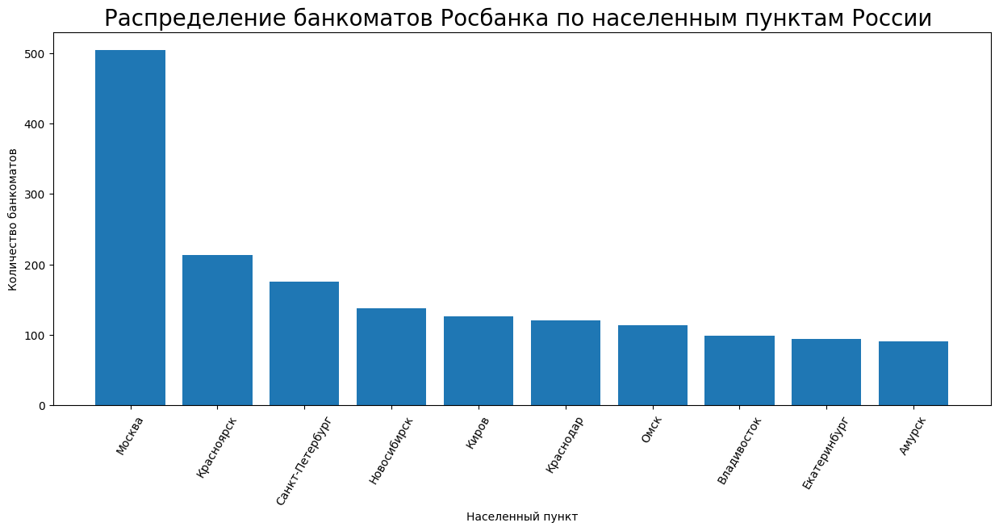

In [ ]:
plt.figure(figsize=(15, 6))
plt.bar(x=top_10_atms['settlement'], height=top_10_atms['atm'])
plt.title('Распределение банкоматов Росбанка по населенным пунктам России ', fontsize=20)
sns.color_palette('pastel')
plt.xticks(rotation=60)
plt.xlabel('Населенный пункт')
plt.ylabel('Количество банкоматов')

plt.show()

__12. Посмотрим на распределение таргета:__

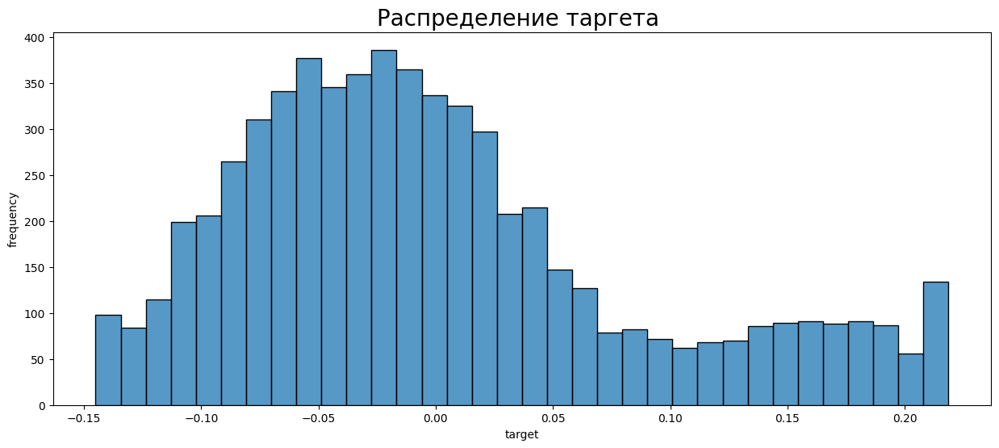

In [ ]:
plt.figure(figsize=(15, 6))
plt.title('Распределение таргета ', fontsize=20)
sns.histplot(df_train, x='target')
sns.color_palette('pastel')
plt.xlabel('target')
plt.ylabel('frequency')

plt.show()

In [ ]:
print(f'Имеем распределение со средним {df_train.target.mean():.3f} и стандартным отклонением {df_train.target.std():.2f}')

Имеем распределение со средним 0.001 и стандартным отклонением 0.09


In [ ]:
df_train['address_rus'][1343]

'Магаданская улица, 31, посёлок Хандыга, Томпонский муниципальный район, Республика Саха (Якутия), Россия, 678720'

Сделаем промежуточный вывод о структуре данных и потенциальных проблемах. По записи 1343 (см. ячейку выше) можно видеть муниципальный формат записи адреса. В муниципальном делении указывают структуры местного самоуправления, например, регион, районы, сельские и городские поселения, муниципальные округа. Данный факт усложняет формат записи адреса для его парсинга на составлящие. Также имеются записи о банкоматах в нашем датасете, адресов на русском с географическими координатами которых нет вовсе.

__13. Построим корреляционную матрицу с количеством банкоматов и городом:__

Для этого сперва закодируем каждый город с помощью Target encoding, т.e. каждую категорию, в нашем случае это город, закодируем средним значением целевой переменной по этой категории.

In [54]:
df_train['settlement'].nunique()

486

In [55]:
df_train['feature_mean'] = df_train.groupby('settlement')['target'].transform('mean')

Если кодировать при помощи счетчиков сразу все обучающие данные, то мы переобучимся. Применим сглаживание по следующей формуле:

$$
p = \frac{\text{mean(target)} \cdot n_{\text{rows}} + \alpha \cdot \text{GlobalTarget}}{n_{\text{rows}} + \alpha}
$$

In [56]:
def counter_with_smoothing(df, settlement, target, alpha):
    """
    p - число, которым кодируем категорию
    n_rows - число строк в категории
    mean(target) - среднее значение целевой переменной по категории
    Global_target - среднее значение целевой переменной по всей обучающей выборке
    α - гиперпараметр
    """
    df['feature_mean'] = df.groupby(settlement)[target].transform('mean')

    global_mean = df[target].mean()

    df['settlement_count'] = df.groupby(settlement)[target].transform('count')

    df['p'] = (df['feature_mean'] * df['settlement_count'] + alpha * global_mean) / (df['settlement_count'] + alpha)

    return df

In [57]:
df_train = counter_with_smoothing(df_train, 'settlement', 'target', 30)

In [58]:
df_train

,id,atm_group,address,address_rus,lat,long,target,len_address,postal_code,len_postal_code,country,settlement,street_name,number,feature_mean,settlement_count,p
0,"8,526.00",32.00,"EMELYANOVA,34 Y-SAKHALINSK","улица А.О. Емельянова, 34, Южно-Сахалинск, Сах...",46.94,142.74,0.01,70.00,None,NaN,Россия,Южно-Сахалинск,А.О. Емельянова,34,0.04,28.00,0.02
1,"8,532.00",32.00,"KOMSOMOLSKAYA,259B Y.SAKHALINSK","Комсомольская улица, 259, Южно-Сахалинск, Саха...",46.94,142.75,0.03,69.00,None,NaN,Россия,Комсомольск,Комсомольская,259,0.04,66.00,0.03
2,"8,533.00",32.00,"KOMMUN. PR., 32 YUZHNO SAKHAL","Коммунистический проспект, Южно-Сахалинск, Сах...",46.96,142.74,0.01,70.00,None,NaN,Россия,Южно-Сахалинск,Коммунистический проспект,None,0.04,28.00,0.02
3,"8,684.00",32.00,"LENINGRADSKIY PR.,76A MOSCOW","Ленинградский проспект, 76А, Москва, Россия, 1...",55.81,37.52,-0.09,51.00,125315,6.00,Россия,Москва,Ленинградский проспект,76А,0.04,504.00,0.03
4,37.00,32.00,"GVARDEYSKAYA PL., 2 NORILSK","Гвардейская площадь, 2, Норильск, Красноярский...",69.34,88.21,0.08,67.00,663302,6.00,Россия,Гвардейск,Гвардейская площадь,2,0.01,5.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6256,"4,402.00","8,083.00","FEDORA POPOVA, 14 Yakutsk","улица Федора Попова, 14, Якутск, Республика Са...",62.05,129.75,0.21,73.00,677009,6.00,Россия,Якутск,Федора Попова,14,0.04,65.00,0.02
6257,"4,421.00","8,083.00","STROITELEY, 43 Novokuznetsk","проспект Строителей, 43, Новокузнецк, Кемеровс...",53.77,87.12,0.06,73.00,654005,6.00,Россия,Новокузнецк,проспект Строителей,43,-0.03,32.00,-0.01
6258,"4,422.00","8,083.00","Rublevskoye sh, 62 Moskva","Рублёвское шоссе, 62, Москва, Россия, 121609",55.77,37.38,0.11,44.00,121609,6.00,Россия,Москва,Рублёвское шоссе,62,0.04,504.00,0.03
6259,"4,426.00","8,083.00","EFANOVA, 22 Zyryanskoye","улица Ефанова, 22, село Зырянское, Зырянский р...",56.84,86.64,0.15,75.00,None,NaN,Россия,Томск,Ефанова,22,0.04,85.00,0.03


<Axes: >

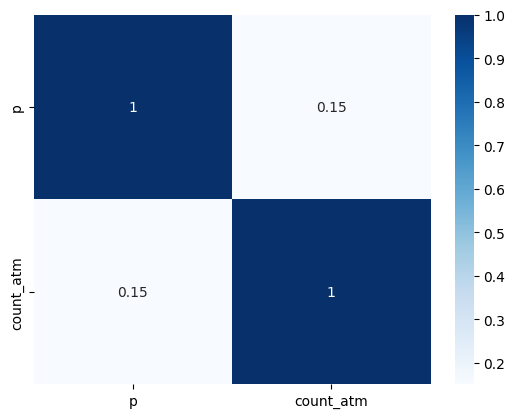

In [ ]:
df_corr = df_train.groupby('settlement', as_index=False).agg(count_atm=('lat', 'count'), \
                                                               p=('p', 'mean'))

sns.heatmap(df_corr[['p', 'count_atm']].corr(), cmap="Blues", annot=True)

Попробую проинтепретировать полученное значение: в целом у нас наблюдается положительная корреляция между закодированным числом города и числом банкоматов в нем, но зависимость слабая. Хоть и есть некоторая связь, но она вряд ли объясняет поведение числа банкоматов (count_atm).

__Применим библиотеку Folium для визуализации геоданных наших банкоматов:__

In [ ]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import folium
from folium.plugins import HeatMap

In [ ]:
atm_coordinates = df_train[(df_train['lat'].notnull()) & (df_train['long'].notnull())][['lat', 'long']]

In [ ]:
if 'count' not in atm_coordinates.columns:
    atm_coordinates['count'] = 1  # Если нет столбца с весами, назначим по 1 банкомату

# Создаем карту
m = folium.Map(location=[atm_coordinates['lat'].mean(), atm_coordinates['long'].mean()], zoom_start=6)

# Добавляем слой тепловой карты
heat_data = atm_coordinates[['lat', 'long', 'count']].values.tolist()
HeatMap(heat_data).add_to(m)

# Сохраняем карту в HTML
m.save("heatmap.html")
print("Тепловая карта сохранена в файл heatmap.html")

Тепловая карта сохранена в файл heatmap.html


In [ ]:
df_train.isna().sum()

id                     0
atm_group              0
address                0
address_rus          304
lat                  304
long                 304
target                 0
len_address          304
postal_code         1563
len_postal_code     1563
country              304
settlement           320
street_name          461
number               503
feature_mean         320
settlement_count     320
p                    320
dtype: int64

## __Часть 2 | Применение моделей машинного обучения (ML)__

### 1. Модель только на вещественных признаках

Начнем обучение ML моделей с линейной регрессии. Оценивать результаты моделей будем с помощью метрик качества $R^2$, $MAE$ и $MAPE$.

In [59]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error as MAE, mean_absolute_percentage_error as MAPE, r2_score as R2

Отберем записи, в которых присутствуют сведения о широте и долготе:

In [60]:
df_train_filtered = df_train[(df_train['lat'].notnull()) & (df_train['long'].notnull())]
df_test_filtered = df_test[(df_test['lat'].notnull()) & (df_test['long'].notnull())]

In [61]:
df_test_filtered['settlement_count'] = df_test_filtered.groupby('settlement')['atm_group'].transform('count')

<ipython-input-61-b33c21138c23>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_test_filtered['settlement_count'] = df_test_filtered.groupby('settlement')['atm_group'].transform('count')


In [62]:
df_train_filtered['settlement_count'].fillna(round(df_train_filtered['settlement_count'].median(), 2), inplace=True)
df_test_filtered['settlement_count'].fillna(round(df_test_filtered['settlement_count'].median(), 2), inplace=True)

<ipython-input-62-4ca1b59179cc>:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_train_filtered['settlement_count'].fillna(round(df_train_filtered['settlement_count'].median(), 2), inplace=True)
<ipython-input-62-4ca1b59179cc>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train_filtered['settlement_count'].fillna(round(df_train_filter

In [63]:
df_train_filtered.isna().sum()

,0
id,0
atm_group,0
address,0
address_rus,0
lat,0
long,0
target,0
len_address,0
postal_code,1259
len_postal_code,1259


In [64]:
df_train_filtered.dtypes

,0
id,float64
atm_group,float64
address,object
address_rus,object
lat,float64
long,float64
target,float64
len_address,float64
postal_code,object
len_postal_code,float64


Разделение данных на признаки (X) и целевую переменную (y):

In [65]:
df_train_filtered

,id,atm_group,address,address_rus,lat,long,target,len_address,postal_code,len_postal_code,country,settlement,street_name,number,feature_mean,settlement_count,p
0,"8,526.00",32.00,"EMELYANOVA,34 Y-SAKHALINSK","улица А.О. Емельянова, 34, Южно-Сахалинск, Сах...",46.94,142.74,0.01,70.00,None,NaN,Россия,Южно-Сахалинск,А.О. Емельянова,34,0.04,28.00,0.02
1,"8,532.00",32.00,"KOMSOMOLSKAYA,259B Y.SAKHALINSK","Комсомольская улица, 259, Южно-Сахалинск, Саха...",46.94,142.75,0.03,69.00,None,NaN,Россия,Комсомольск,Комсомольская,259,0.04,66.00,0.03
2,"8,533.00",32.00,"KOMMUN. PR., 32 YUZHNO SAKHAL","Коммунистический проспект, Южно-Сахалинск, Сах...",46.96,142.74,0.01,70.00,None,NaN,Россия,Южно-Сахалинск,Коммунистический проспект,None,0.04,28.00,0.02
3,"8,684.00",32.00,"LENINGRADSKIY PR.,76A MOSCOW","Ленинградский проспект, 76А, Москва, Россия, 1...",55.81,37.52,-0.09,51.00,125315,6.00,Россия,Москва,Ленинградский проспект,76А,0.04,504.00,0.03
4,37.00,32.00,"GVARDEYSKAYA PL., 2 NORILSK","Гвардейская площадь, 2, Норильск, Красноярский...",69.34,88.21,0.08,67.00,663302,6.00,Россия,Гвардейск,Гвардейская площадь,2,0.01,5.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6256,"4,402.00","8,083.00","FEDORA POPOVA, 14 Yakutsk","улица Федора Попова, 14, Якутск, Республика Са...",62.05,129.75,0.21,73.00,677009,6.00,Россия,Якутск,Федора Попова,14,0.04,65.00,0.02
6257,"4,421.00","8,083.00","STROITELEY, 43 Novokuznetsk","проспект Строителей, 43, Новокузнецк, Кемеровс...",53.77,87.12,0.06,73.00,654005,6.00,Россия,Новокузнецк,проспект Строителей,43,-0.03,32.00,-0.01
6258,"4,422.00","8,083.00","Rublevskoye sh, 62 Moskva","Рублёвское шоссе, 62, Москва, Россия, 121609",55.77,37.38,0.11,44.00,121609,6.00,Россия,Москва,Рублёвское шоссе,62,0.04,504.00,0.03
6259,"4,426.00","8,083.00","EFANOVA, 22 Zyryanskoye","улица Ефанова, 22, село Зырянское, Зырянский р...",56.84,86.64,0.15,75.00,None,NaN,Россия,Томск,Ефанова,22,0.04,85.00,0.03


In [66]:
X_train = df_train_filtered[['lat', 'long', 'settlement_count']]
y_train = df_train_filtered['target']

In [67]:
X_test = df_test_filtered[['lat', 'long', 'settlement_count']]

Обучим модель на тренировочных данных:

In [ ]:
model_lr = LinearRegression()
model_lr.fit(X_train, y_train)

LinearRegression()

Сделаем предсказания на тренировочных данных:

In [ ]:
y_train_predict = model_lr.predict(X_train)

Посчитаем метрики качества:

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_train, y_train_predict), 3)}
mape_train={round(MAPE(y_train, y_train_predict), 3)}
R2_train={round(R2(y_train, y_train_predict), 3)}
''')

Metrics:
mae_train=0.066
mape_train=1.981
R2_train=0.045



Выведем веса модели:

In [ ]:
weigths = model_lr.coef_
print("Веса:", weigths)

Веса: [-1.73491054e-05  3.98816467e-04  1.13059512e-04]


### 2. Приведем признаки к одному масштабу

In [68]:
from sklearn.preprocessing import StandardScaler

Обучим стандартизатор на тренировочных данных:

In [69]:
scaler = StandardScaler()
scaler.fit(X_train)

StandardScaler()

Стандартизируем тренировочные данные:

In [70]:
X_train_scaled = scaler.transform(X_train)

Обучим модель на тренировочных данных, которые стандартизировали:

In [ ]:
model_lr_scaled = LinearRegression()

In [ ]:
model_lr_scaled.fit(X_train_scaled, y_train)

LinearRegression()

Сделаем предсказания на тренировочных данных:

In [ ]:
y_train_scaled_predict = model_lr_scaled.predict(X_train_scaled)

Посчитаем метрики качества:

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_train, y_train_scaled_predict), 3)}
mape_train={round(MAPE(y_train, y_train_scaled_predict), 3)}
R2_train={round(R2(y_train, y_train_scaled_predict), 3)}
''')

Metrics:
mae_train=0.066
mape_train=1.981
R2_train=0.045



Стандартизация не помогла прибавить в качестве.

Выведем веса модели:

In [ ]:
weigths = model_lr_scaled.coef_
print("Веса:", weigths)

Веса: [-7.53963613e-05  1.31678844e-02  1.50872927e-02]


### 2. Добавим категориальные переменные

Обучим модель на сей раз с помощью гребневой (ridge) регрессии и класса GridSearchCV. Кроссвалидируемся по 10-ти фолдам:

Сделаем признами 'atm_group' и 'postal_code' категориальными:

In [71]:
df_train_filtered['atm_group'] = df_train_filtered['atm_group'].astype(object)
df_train_filtered['postal_code'] = df_train_filtered['postal_code'].astype(object)

df_test_filtered['atm_group'] = df_test_filtered['atm_group'].astype(object)
df_test_filtered['postal_code'] = df_test_filtered['postal_code'].astype(object)

<ipython-input-71-7dc5195769a6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train_filtered['atm_group'] = df_train_filtered['atm_group'].astype(object)
<ipython-input-71-7dc5195769a6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_train_filtered['postal_code'] = df_train_filtered['postal_code'].astype(object)
<ipython-input-71-7dc5195769a6>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See 

In [ ]:
df_train_filtered.dtypes

,0
id,float64
atm_group,object
address,object
address_rus,object
lat,float64
long,float64
target,float64
len_address,float64
postal_code,object
len_postal_code,float64


In [72]:
X_train_with_cat = df_train_filtered[['lat', 'long', 'settlement', 'street_name', 'settlement_count', 'atm_group', 'postal_code']]
X_test_with_cat = df_test_filtered[['lat', 'long', 'settlement', 'street_name', 'settlement_count', 'atm_group', 'postal_code']]

In [73]:
from sklearn.preprocessing import OneHotEncoder

Воспользуемся OneHotEncoder:

In [74]:
one_hot_enc = OneHotEncoder(drop='first', handle_unknown='ignore')

Запишем категориальные признаки:

In [75]:
cat_features = ['settlement', 'street_name', 'atm_group', 'postal_code']

Обучим и преобразуем тренировочные данные:

In [76]:
encoded_train = one_hot_enc.fit_transform(X_train_with_cat[cat_features]).toarray()

Преобразуем тестовые данные:

In [77]:
encoded_test = one_hot_enc.transform(X_test_with_cat[cat_features]).toarray()

/usr/local/lib/python3.11/dist-packages/sklearn/preprocessing/_encoders.py:246: UserWarning: Found unknown categories in columns [0, 1, 3] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


Создадим датафреймы для закодированных признаков:

In [78]:
encoded_train_df = pd.DataFrame(encoded_train,
                                columns=one_hot_enc.get_feature_names_out(cat_features),
                                index=X_train_with_cat.index)

In [79]:
encoded_test_df = pd.DataFrame(encoded_test,
                              columns=one_hot_enc.get_feature_names_out(cat_features),
                              index=X_test_with_cat.index)

Дропнем исходные категориальные признаки:

In [80]:
X_train_encoded = pd.concat([X_train_with_cat.drop(columns=cat_features), encoded_train_df], axis=1)
X_test_encoded = pd.concat([X_test_with_cat.drop(columns=cat_features), encoded_test_df], axis=1)

In [81]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV

Зададим варианты гиперпараметра alpha, который будем поочереди применять на модели:

In [ ]:
params = {'alpha' : [0.01, 0.2, 0.4, 0.6, 0.8, 1]}

In [ ]:
ridge_model = Ridge(random_state=42)

Подберем гиперпараметры по кросс-валидации:

In [ ]:
ridge = GridSearchCV(ridge_model, params, scoring='r2', cv=10)
ridge.fit(X_train_encoded, y_train)

GridSearchCV(cv=10, estimator=Ridge(random_state=42),
             param_grid={'alpha': [0.01, 0.2, 0.4, 0.6, 0.8, 1]}, scoring='r2')

Сделаем предсказания на тренировочных данных:

In [ ]:
y_train_encoded_predict = ridge.predict(X_train_encoded)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_train, y_train_encoded_predict), 3)}
mape_train={round(MAPE(y_train, y_train_encoded_predict), 3)}
R2_train={round(R2(y_train, y_train_encoded_predict), 3)}
''')

Metrics:
mae_train=0.023
mape_train=1.89
R2_train=0.874



Из полученных результатов видно, чо лучше всех себя проявила модель Ridge. Низкие знаения MAE и MAPE говорят о точности предсказаний, а относительно высокий R2 подтверждает, что модель объясняет значительную часть дисперсии данных. Проинтепретерируем полученные результаты: мы добавили в модель категориальные признаки, которые несут в себе полезную информацию и это помогло модели лучше понять и объяснить данные.

Нарисуем получившиеся значения метрик для всех моделей:

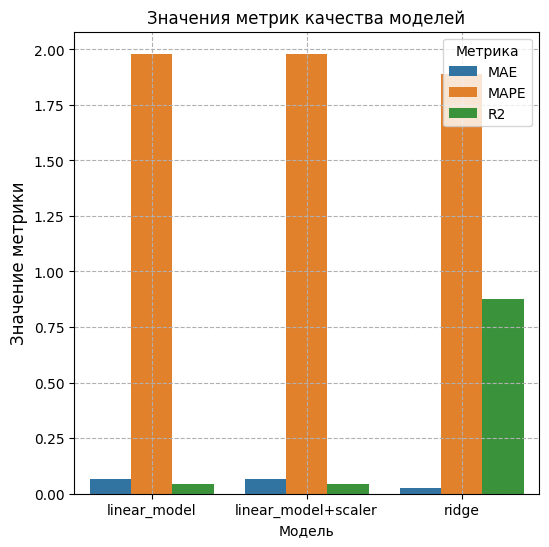

In [ ]:
metrics = {
    'Model': ['linear_model', 'linear_model+scaler', 'ridge'],
    'MAE': [0.066, 0.066, 0.023],
    'MAPE': [1.981, 1.981, 1.89],
    'R2': [0.045, 0.045, 0.874]
}

df = pd.DataFrame(metrics)

long_df = df.melt(id_vars='Model', var_name='Metric', value_name='Value')

plt.figure(figsize=(6, 6))
sns.barplot(data=long_df, x='Model', y='Value', hue='Metric')

plt.title('Значения метрик качества моделей')
plt.xlabel('Модель')
plt.ylabel('Значение метрики', fontsize=12)
plt.legend(title='Метрика')
plt.grid(linestyle='--')
plt.show()


## __Часть 3 | Попытка улучшить предыдущий результат с помощью более аккуратного подбора гиперпараметров и признаков для обучения моделей. Применение методов обработки текстов__

In [99]:
from sklearn.model_selection import train_test_split

In [ ]:
df_train_filtered

,id,atm_group,address,address_rus,lat,long,target,len_address,postal_code,len_postal_code,country,settlement,street_name,number,feature_mean,settlement_count,p
0,"8,526.00",32.00,"EMELYANOVA,34 Y-SAKHALINSK","улица А.О. Емельянова, 34, Южно-Сахалинск, Сах...",46.94,142.74,0.01,70.00,None,NaN,Россия,Южно-Сахалинск,А.О. Емельянова,34,0.04,28.00,0.02
1,"8,532.00",32.00,"KOMSOMOLSKAYA,259B Y.SAKHALINSK","Комсомольская улица, 259, Южно-Сахалинск, Саха...",46.94,142.75,0.03,69.00,None,NaN,Россия,Комсомольск,Комсомольская,259,0.04,66.00,0.03
2,"8,533.00",32.00,"KOMMUN. PR., 32 YUZHNO SAKHAL","Коммунистический проспект, Южно-Сахалинск, Сах...",46.96,142.74,0.01,70.00,None,NaN,Россия,Южно-Сахалинск,Коммунистический проспект,None,0.04,28.00,0.02
3,"8,684.00",32.00,"LENINGRADSKIY PR.,76A MOSCOW","Ленинградский проспект, 76А, Москва, Россия, 1...",55.81,37.52,-0.09,51.00,125315,6.00,Россия,Москва,Ленинградский проспект,76А,0.04,504.00,0.03
4,37.00,32.00,"GVARDEYSKAYA PL., 2 NORILSK","Гвардейская площадь, 2, Норильск, Красноярский...",69.34,88.21,0.08,67.00,663302,6.00,Россия,Гвардейск,Гвардейская площадь,2,0.01,5.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6256,"4,402.00","8,083.00","FEDORA POPOVA, 14 Yakutsk","улица Федора Попова, 14, Якутск, Республика Са...",62.05,129.75,0.21,73.00,677009,6.00,Россия,Якутск,Федора Попова,14,0.04,65.00,0.02
6257,"4,421.00","8,083.00","STROITELEY, 43 Novokuznetsk","проспект Строителей, 43, Новокузнецк, Кемеровс...",53.77,87.12,0.06,73.00,654005,6.00,Россия,Новокузнецк,проспект Строителей,43,-0.03,32.00,-0.01
6258,"4,422.00","8,083.00","Rublevskoye sh, 62 Moskva","Рублёвское шоссе, 62, Москва, Россия, 121609",55.77,37.38,0.11,44.00,121609,6.00,Россия,Москва,Рублёвское шоссе,62,0.04,504.00,0.03
6259,"4,426.00","8,083.00","EFANOVA, 22 Zyryanskoye","улица Ефанова, 22, село Зырянское, Зырянский р...",56.84,86.64,0.15,75.00,None,NaN,Россия,Томск,Ефанова,22,0.04,85.00,0.03


__Для побучения возьмем следующие признаки:__

In [ ]:
cols_for_fit = ['atm_group', 'lat', 'long', 'postal_code', 'settlement', 'street_name', 'settlement_count', 'p', 'target', 'number']

In [ ]:
X = df_train_filtered[cols_for_fit].drop(columns='target').copy()
y = df_train_filtered['target'].copy()

In [ ]:
X.shape

(5957, 9)

In [ ]:
y.shape

(5957,)

In [ ]:
X.isna().sum()

,0
atm_group,0
lat,0
long,0
postal_code,1259
settlement,16
street_name,157
settlement_count,0
p,16
number,199


Заполним пропуски для избежания ошибок:

In [ ]:
X_notna = X.copy()

In [ ]:
X_notna.isna().sum()

,0
atm_group,0
lat,0
long,0
postal_code,1259
settlement,16
street_name,157
settlement_count,0
p,16
number,199


__Необходимо обработать имеющиеся пропуски, попробуем сделать следующее:__

In [ ]:
X_notna['p'].fillna(X_notna['p'].median(), inplace=True)
X_notna['street_name'].fillna('999', inplace=True)
X_notna['settlement'].fillna('111', inplace=True)
X_notna['postal_code'].fillna('-999', inplace=True)
X_notna['number'].fillna('222', inplace=True)

<ipython-input-90-911cf1a85911>:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_notna['p'].fillna(X_notna['p'].median(), inplace=True)
<ipython-input-90-911cf1a85911>:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', 

In [101]:
RANDOM_STATE = 42

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X_notna, y, test_size=0.3, random_state=RANDOM_STATE)

In [ ]:
numeric_features = X.select_dtypes(include=['float', 'int']).columns.tolist()
categorical_features = X.select_dtypes(include=['object', 'category']).columns.tolist()

In [ ]:
scaler = StandardScaler()

In [ ]:
X_train_num = scaler.fit_transform(X_train[numeric_features])
X_val_num = scaler.transform(X_val[numeric_features])

In [ ]:
ohe = OneHotEncoder(drop='first', handle_unknown='ignore')

In [ ]:
X_train_cat = ohe.fit_transform(X_train[categorical_features]).toarray()
X_val_cat = ohe.transform(X_val[categorical_features]).toarray()

/usr/local/lib/python3.11/dist-packages/sklearn/preprocessing/_encoders.py:246: UserWarning: Found unknown categories in columns [1, 2, 3, 4] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [ ]:
X_train_cat_df = pd.DataFrame(X_train_cat,
                              columns=ohe.get_feature_names_out(categorical_features),
                              index=X_train.index)

In [ ]:
X_val_cat_df = pd.DataFrame(X_val_cat,
                            columns=ohe.get_feature_names_out(categorical_features),
                            index=X_val.index)

In [ ]:
X_train_num_df = pd.DataFrame(X_train_num,
                              columns=scaler.get_feature_names_out(numeric_features),
                              index=X_train.index)

In [ ]:
X_val_num_df = pd.DataFrame(X_val_num,
                            columns=scaler.get_feature_names_out(numeric_features),
                            index=X_val.index)

In [ ]:
X_train_df = pd.concat([X_train_cat_df, X_train_num_df], axis=1)
X_val_df = pd.concat([X_val_cat_df, X_val_num_df], axis=1)

In [ ]:
np.logspace(-5, 5, 10)

array([1.00000000e-05, 1.29154967e-04, 1.66810054e-03, 2.15443469e-02,
       2.78255940e-01, 3.59381366e+00, 4.64158883e+01, 5.99484250e+02,
       7.74263683e+03, 1.00000000e+05])

In [ ]:
params = {'alpha': [0.1, 0.2, 0.5, 0.8, 1, 3, 5]}

In [ ]:
ridge_model = Ridge(random_state=RANDOM_STATE)

In [ ]:
gs = GridSearchCV(ridge_model, params, scoring='r2', cv=5)
gs.fit(X_train_df, y_train)

GridSearchCV(cv=5, estimator=Ridge(random_state=42),
             param_grid={'alpha': [0.1, 0.2, 0.5, 0.8, 1, 3, 5]}, scoring='r2')

In [ ]:
y_val_predict = gs.best_estimator_.predict(X_val_df)

In [ ]:
len(y_val_predict)

1788

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_val_predict), 3)}
mape_train={round(MAPE(y_val, y_val_predict), 3)}
R2_train={round(R2(y_val, y_val_predict), 3)}
''')

Metrics:
mae_train=0.036
mape_train=1.892
R2_train=0.713



### Методы для обрабокти тестов

В качестве методов опробуем:  
- BoW (bag of words);
- TF-IDF
- word2vec

### 4.1 Реализуем BoW

__4.1.1__
- Возьмем мешок слов и обучим гребневую регрессию;
- Пропуски в колонках заполним медианой и новыми категориями по этим колонкам;
- Список признаков для обучения возьмем следующий: atm_group, address_rus, lat, long, postal_code,
settlement, street_name, settlement_count, p, number

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

In [ ]:
cnt_vec = CountVectorizer(lowercase=True)

In [ ]:
X_df_for_texts = df_train_filtered[['atm_group', 'address_rus', 'lat', 'long', 'postal_code', 'settlement', 'street_name', 'settlement_count', 'p', 'target', 'number']].reset_index()

In [ ]:
X_df_for_texts.isna().sum()

,0
index,0
atm_group,0
address_rus,0
lat,0
long,0
postal_code,1259
settlement,16
street_name,157
settlement_count,0
p,16


In [ ]:
X_df_for_texts.drop('index', axis=1, inplace=True)

Необходимо обработать имеющиеся пропуски, попробуем сделать следующее:

In [ ]:
X_df_for_texts['p'].fillna(X_df_for_texts['p'].median(), inplace=True)
X_df_for_texts['street_name'].fillna('999', inplace=True)
X_df_for_texts['settlement'].fillna('111', inplace=True)
X_df_for_texts['postal_code'].fillna('-999', inplace=True)
X_df_for_texts['number'].fillna('222', inplace=True)

<ipython-input-114-65a04234fcd1>:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_df_for_texts['p'].fillna(X_df_for_texts['p'].median(), inplace=True)
<ipython-input-114-65a04234fcd1>:7: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, 

In [ ]:
X_df_for_texts.isna().sum()

,0
atm_group,0
address_rus,0
lat,0
long,0
postal_code,0
settlement,0
street_name,0
settlement_count,0
p,0
target,0


In [ ]:
X_train_addresses = X_df_for_texts[['address_rus']].copy()
y_train_addresses = X_df_for_texts['target'].copy()

In [ ]:
X_bow  = cnt_vec.fit_transform(X_train_addresses['address_rus'])

In [ ]:
X_bow_df = pd.DataFrame(X_bow.toarray(), columns=cnt_vec.get_feature_names_out(), index=X_train_addresses.index)

In [ ]:
df_train_bow = X_df_for_texts.drop(['address_rus'], axis=1)

In [ ]:
df_train_bow = pd.concat([df_train_bow, X_bow_df], axis=1)

In [ ]:
df_train_bow.shape

(5957, 5824)

In [ ]:
df_train_bow

,atm_group,lat,long,postal_code,settlement,street_name,settlement_count,p,target,number,...,ярцевское,ясная,ясногорск,ястынская,ят,ях,яшина,яшкуль,яшкульский,яшьлек
0,32.00,46.94,142.74,-999,Южно-Сахалинск,А.О. Емельянова,28.00,0.02,0.01,34,...,0,0,0,0,0,0,0,0,0,0
1,32.00,46.94,142.75,-999,Комсомольск,Комсомольская,66.00,0.03,0.03,259,...,0,0,0,0,0,0,0,0,0,0
2,32.00,46.96,142.74,-999,Южно-Сахалинск,Коммунистический проспект,28.00,0.02,0.01,222,...,0,0,0,0,0,0,0,0,0,0
3,32.00,55.81,37.52,125315,Москва,Ленинградский проспект,504.00,0.03,-0.09,76А,...,0,0,0,0,0,0,0,0,0,0
4,32.00,69.34,88.21,663302,Гвардейск,Гвардейская площадь,5.00,0.00,0.08,2,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5952,"8,083.00",62.05,129.75,677009,Якутск,Федора Попова,65.00,0.02,0.21,14,...,0,0,0,0,0,0,0,0,0,0
5953,"8,083.00",53.77,87.12,654005,Новокузнецк,проспект Строителей,32.00,-0.01,0.06,43,...,0,0,0,0,0,0,0,0,0,0
5954,"8,083.00",55.77,37.38,121609,Москва,Рублёвское шоссе,504.00,0.03,0.11,62,...,0,0,0,0,0,0,0,0,0,0
5955,"8,083.00",56.84,86.64,-999,Томск,Ефанова,85.00,0.03,0.15,22,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
X = df_train_bow.drop(columns=['target'])
y = df_train_bow['target']

In [ ]:
numeric_features = X.select_dtypes(include=['float', 'int']).columns.tolist()
categorical_features = X.select_dtypes(include=['object', 'category']).columns.tolist()

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=RANDOM_STATE)

In [ ]:
scaler = StandardScaler()

In [ ]:
X_train_num = pd.DataFrame(scaler.fit_transform(X_train[numeric_features]), columns=numeric_features, index=X_train.index)

In [ ]:
X_val_num = pd.DataFrame(scaler.transform(X_val[numeric_features]), columns=numeric_features, index=X_val.index)

In [ ]:
ohe = OneHotEncoder(drop='first', handle_unknown='ignore', sparse_output=False)

In [ ]:
X_train_cat = pd.DataFrame(ohe.fit_transform(X_train[categorical_features]),
                           columns=ohe.get_feature_names_out(categorical_features),
                           index=X_train.index)

In [ ]:
X_val_cat = pd.DataFrame(ohe.transform(X_val[categorical_features]),
                           columns=ohe.get_feature_names_out(categorical_features),
                           index=X_val.index)

/usr/local/lib/python3.11/dist-packages/sklearn/preprocessing/_encoders.py:246: UserWarning: Found unknown categories in columns [1, 2, 3, 4] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [ ]:
X_train_final = pd.concat([X_train_num, X_train_cat], axis=1)
X_val_final = pd.concat([X_val_num, X_val_cat], axis=1)

In [ ]:
lr = LinearRegression()
lr.fit(X_train_final, y_train)

LinearRegression()

In [ ]:
y_bow_predict = lr.predict(X_val_final)

In [ ]:
y_bow_predict

array([-0.05602936, -0.45913605,  0.07030711, ...,  0.05333189,
       -0.0237757 ,  0.18883791])

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_bow_predict), 3)}
mape_train={round(MAPE(y_val, y_bow_predict), 3)}
R2_train={round(R2(y_val, y_bow_predict), 3)}
''')

Metrics:
mae_train=0.112
mape_train=5.95
R2_train=-2.92



__Как реультат: получили ужасное качество.__

__4.1.2__
- Возьмем мешок слов и обучим случайный лес;
- Список признаков для обучения возьмем следующие: atm_group, address_rus, lat, long, postal_code, settlement, street_name, settlement_count, p, number;
- Обучимся на данных, где пропуски в колонках заполним медианой и новыми категориями по этим колонкам.


In [ ]:
from sklearn.ensemble import RandomForestRegressor

In [ ]:
rf = RandomForestRegressor(random_state=RANDOM_STATE)
rf.fit(X_train_final, y_train)
y_predict_rf = rf.predict(X_val_final)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_rf), 3)}
mape_train={round(MAPE(y_val, y_predict_rf), 3)}
R2_train={round(R2(y_val, y_predict_rf), 3)}
''')

Metrics:
mae_train=0.034
mape_train=1.736
R2_train=0.729



- __Попробуем теперь подобрать гиперпараметры:__

In [ ]:
params = {"n_estimators": [100, 200, 300, 500],
          "max_depth": [None, 5, 10, 20],
          "min_samples_split": [2, 5, 10],
          "min_samples_leaf": [1, 3, 5],
          "max_features": ["sqrt", "log2"]}

In [ ]:
rf = RandomForestRegressor(random_state=RANDOM_STATE, n_jobs=-1)

In [ ]:
gs = GridSearchCV(rf, params, cv=5, scoring="r2", n_jobs=-1, verbose=2)

In [ ]:
gs.fit(X_train_final, y_train)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits


/usr/local/lib/python3.11/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


GridSearchCV(cv=5, estimator=RandomForestRegressor(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [None, 5, 10, 20],
                         'max_features': ['sqrt', 'log2'],
                         'min_samples_leaf': [1, 3, 5],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300, 500]},
             scoring='r2', verbose=2)

In [ ]:
best_rf = RandomForestRegressor(**gs.best_params_, random_state=RANDOM_STATE, n_jobs=-1)
best_rf.fit(X_train_final, y_train)

RandomForestRegressor(max_features='sqrt', n_jobs=-1, random_state=42)

In [ ]:
y_predict_best_rf = best_rf.predict(X_val_final)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_best_rf), 3)}
mape_train={round(MAPE(y_val, y_predict_best_rf), 3)}
R2_train={round(R2(y_val, y_predict_best_rf), 3)}
''')

Metrics:
mae_train=0.038
mape_train=1.751
R2_train=0.684



- __Возьмем в качестве признаков только адреса на русском и попробуем на них обучиться:__

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X_bow_df, y, test_size=0.3, random_state=RANDOM_STATE)

In [ ]:
rf = RandomForestRegressor(random_state=RANDOM_STATE)
rf.fit(X_train, y_train)
y_predict_rf = rf.predict(X_val)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_rf), 3)}
mape_train={round(MAPE(y_val, y_predict_rf), 3)}
R2_train={round(R2(y_val, y_predict_rf), 3)}
''')

Metrics:
mae_train=0.06
mape_train=2.422
R2_train=0.093



- __Попробуем обучиться на данных, где пропуски в колонках заполним медианой и новыми категориями по этим колонкам:__

In [ ]:
rf.fit(X_train_df, y_train)
y_predict_rf = rf.predict(X_val_df)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_rf), 3)}
mape_train={round(MAPE(y_val, y_predict_rf), 3)}
R2_train={round(R2(y_val, y_predict_rf), 3)}
''')

Metrics:
mae_train=0.034
mape_train=1.797
R2_train=0.728



__4.1.3__

- Попробуем на мешке слов обучить градиентный бустинг;
- Список признаков для обучения возьмем следующие: atm_group, address_rus, lat, long, postal_code, settlement, street_name, settlement_count, number, p;
- Обучимся на данных, где пропуски в колонках заполним медианой и новыми категориями по этим колонкам.

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor

In [ ]:
gbr = GradientBoostingRegressor(random_state=RANDOM_STATE)

In [ ]:
gbr.fit(X_train_final, y_train)
y_predict_gbr = gbr.predict(X_val_final)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_gbr), 3)}
mape_train={round(MAPE(y_val, y_predict_gbr), 3)}
R2_train={round(R2(y_val, y_predict_gbr), 3)}
''')

Metrics:
mae_train=0.036
mape_train=1.878
R2_train=0.717



- __Обучимся на данных, где пропуски в колонках заполним медианой и новыми категориями по этим колонкам:__

In [ ]:
gbr.fit(X_train_df, y_train)
y_predict_gbr = gbr.predict(X_val_df)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_gbr), 3)}
mape_train={round(MAPE(y_val, y_predict_gbr), 3)}
R2_train={round(R2(y_val, y_predict_gbr), 3)}
''')

Metrics:
mae_train=0.037
mape_train=1.878
R2_train=0.715



- __Возьмем в качестве признаков только адреса на русском и попробуем на них обучиться:__

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X_bow_df, y, test_size=0.3, random_state=RANDOM_STATE)

In [ ]:
gbr.fit(X_train, y_train)
y_predict_gbr = gbr.predict(X_val)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_gbr), 3)}
mape_train={round(MAPE(y_val, y_predict_gbr), 3)}
R2_train={round(R2(y_val, y_predict_gbr), 3)}
''')

Metrics:
mae_train=0.063
mape_train=1.402
R2_train=0.102



- __Вернемся к данным, где пропуски в колонках заполним медианой и новыми категориями по этим колонкам и попробуем теперь подобрать гиперпараметры:__

In [ ]:
params = {"n_estimators": [100, 300, 500],
          "learning_rate": [0.01, 0.05, 0.1],
          "max_depth": [3, 5, 7],
          "min_samples_split": [2, 5, 10],
          "min_samples_leaf": [1, 3, 5]}

In [ ]:
gs = GridSearchCV(gbr, params, cv=5, scoring="r2", n_jobs=-1, verbose=2)
gs.fit(X_train_df, y_train)

Fitting 5 folds for each of 243 candidates, totalling 1215 fits


GradientBoostingRegressor(learning_rate=0.05, max_depth=7, min_samples_split=5,
                          n_estimators=300, random_state=42)

In [ ]:
best_gbr = GradientBoostingRegressor(**gs.best_params_, random_state=RANDOM_STATE)
best_gbr.fit(X_train_df, y_train)

GradientBoostingRegressor(learning_rate=0.05, max_depth=7, min_samples_split=5,
                          n_estimators=300, random_state=42)

In [ ]:
y_predict_gbr = best_gbr.predict(X_val_df)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_gbr), 3)}
mape_train={round(MAPE(y_val, y_predict_gbr), 3)}
R2_train={round(R2(y_val, y_predict_gbr), 3)}
''')

Metrics:
mae_train=0.035
mape_train=1.867
R2_train=0.726



## 4.2 Реализуем TF-IDF

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [ ]:
tfidf_vec = TfidfVectorizer(lowercase=True)

__4.2.1__

- Возьмем TF-IDF и обучим случайный лес;
- Список признаков для обучения возьмем следующие: atm_group, address_rus, lat, long, postal_code, settlement, street_name, settlement_count, number, p;
- Обучимся на данных, где пропуски в колонках заполним медианой и новыми категориями по этим колонкам.

In [ ]:
X_tf_idf  = tfidf_vec.fit_transform(X_train_addresses['address_rus'])

In [ ]:
X_tf_idf_df = pd.DataFrame(X_tf_idf.toarray(), columns=cnt_vec.get_feature_names_out(), index=X_train_addresses.index)

In [ ]:
df_train_tf_idf = X_df_for_texts.drop(['address_rus'], axis=1)

In [ ]:
df_train_tf_idf = pd.concat([df_train_tf_idf, X_tf_idf_df], axis=1)

In [ ]:
X = df_train_tf_idf.drop(columns=['target'])
y = df_train_tf_idf['target']

In [ ]:
numeric_features = X.select_dtypes(include=['float', 'int']).columns.tolist()
categorical_features = X.select_dtypes(include=['object', 'category']).columns.tolist()

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=RANDOM_STATE)

In [ ]:
scaler = StandardScaler()

In [ ]:
X_train_num = pd.DataFrame(scaler.fit_transform(X_train[numeric_features]), columns=numeric_features, index=X_train.index)
X_val_num = pd.DataFrame(scaler.transform(X_val[numeric_features]), columns=numeric_features, index=X_val.index)

In [ ]:
ohe = OneHotEncoder(drop='first', handle_unknown='ignore', sparse_output=False)

In [ ]:
X_train_cat = pd.DataFrame(ohe.fit_transform(X_train[categorical_features]),
                           columns=ohe.get_feature_names_out(categorical_features),
                           index=X_train.index)

X_val_cat = pd.DataFrame(ohe.transform(X_val[categorical_features]),
                           columns=ohe.get_feature_names_out(categorical_features),
                           index=X_val.index)

/usr/local/lib/python3.11/dist-packages/sklearn/preprocessing/_encoders.py:246: UserWarning: Found unknown categories in columns [1, 2, 3, 4] during transform. These unknown categories will be encoded as all zeros
  warnings.warn(


In [ ]:
X_train_final = pd.concat([X_train_num, X_train_cat], axis=1)
X_val_final = pd.concat([X_val_num, X_val_cat], axis=1)

In [ ]:
rf = RandomForestRegressor(random_state=RANDOM_STATE)
rf.fit(X_train_final, y_train)
y_predict_rf = rf.predict(X_val_final)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_rf), 3)}
mape_train={round(MAPE(y_val, y_predict_rf), 3)}
R2_train={round(R2(y_val, y_predict_rf), 3)}
''')

Metrics:
mae_train=0.034
mape_train=1.708
R2_train=0.731



- __Попробуем теперь подобрать гиперпараметры:__

In [ ]:
params = {"n_estimators": [100, 200, 300, 500],
          "max_depth": [5, 10, 20],
          "min_samples_split": [2, 5, 10],
          "min_samples_leaf": [1, 3, 5],
          "max_features": ["sqrt", "log2"]}

In [ ]:
rf = RandomForestRegressor(random_state=RANDOM_STATE, n_jobs=-1)

In [ ]:
gs = GridSearchCV(rf, params, cv=5, scoring="r2", n_jobs=-1, verbose=2)

In [ ]:
gs.fit(X_train_final, y_train)

Fitting 5 folds for each of 216 candidates, totalling 1080 fits


GridSearchCV(cv=5, estimator=RandomForestRegressor(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [5, 10, 20],
                         'max_features': ['sqrt', 'log2'],
                         'min_samples_leaf': [1, 3, 5],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300, 500]},
             scoring='r2', verbose=2)

In [ ]:
best_rf = RandomForestRegressor(**gs.best_params_, random_state=RANDOM_STATE, n_jobs=-1)
best_rf.fit(X_train_final, y_train)

RandomForestRegressor(max_depth=20, max_features='sqrt', n_jobs=-1,
                      random_state=42)

In [ ]:
y_predict_best_rf = best_rf.predict(X_val_final)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_best_rf), 3)}
mape_train={round(MAPE(y_val, y_predict_best_rf), 3)}
R2_train={round(R2(y_val, y_predict_best_rf), 3)}
''')

Metrics:
mae_train=0.054
mape_train=1.219
R2_train=0.391



- __Возьмем в качестве признаков только адреса на русском и попробуем на них обучиться:__

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X_tf_idf_df, y, test_size=0.3, random_state=RANDOM_STATE)

In [ ]:
rf = RandomForestRegressor(random_state=RANDOM_STATE)
rf.fit(X_train, y_train)
y_predict_rf = rf.predict(X_val)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_rf), 3)}
mape_train={round(MAPE(y_val, y_predict_rf), 3)}
R2_train={round(R2(y_val, y_predict_rf), 3)}
''')

Metrics:
mae_train=0.06
mape_train=2.254
R2_train=0.088



- __Попробуем обучиться на данных, где пропуски в колонках заполним медианой и новыми категориями по этим колонкам:__

In [ ]:
rf.fit(X_train_df, y_train)
y_predict_rf = rf.predict(X_val_df)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_rf), 3)}
mape_train={round(MAPE(y_val, y_predict_rf), 3)}
R2_train={round(R2(y_val, y_predict_rf), 3)}
''')

Metrics:
mae_train=0.034
mape_train=1.801
R2_train=0.728



__4.2.2__

- Возьмем TF-IDF и обучим градиентный бустинг;
- Список признаков для обучения возьмем следующие: atm_group, address_rus, lat, long, postal_code, settlement, street_name, settlement_count, number, target;
- Обучимся на данных, где пропуски в колонках заполним медианой и новыми категориями по этим колонкам.

In [ ]:
gbr.fit(X_train_final, y_train)
y_predict_gbr = gbr.predict(X_val_final)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_gbr), 3)}
mape_train={round(MAPE(y_val, y_predict_gbr), 3)}
R2_train={round(R2(y_val, y_predict_gbr), 3)}
''')

Metrics:
mae_train=0.036
mape_train=1.853
R2_train=0.717



- __Возьмем в качестве признаков только адреса на русском и попробуем на них обучиться:__

In [ ]:
gbr.fit(X_train, y_train)
y_predict_gbr = gbr.predict(X_val)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_gbr), 3)}
mape_train={round(MAPE(y_val, y_predict_gbr), 3)}
R2_train={round(R2(y_val, y_predict_gbr), 3)}
''')

Metrics:
mae_train=0.064
mape_train=1.424
R2_train=0.092



### 4.3 Реализуем word2vec

In [ ]:
pip install -U spacy

In [ ]:
!python -m spacy download ru_core_news_sm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.3/15.3 MB 45.3 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('ru_core_news_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


In [ ]:
pip install -U spacy gensim

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 4.6 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of thinc to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.7/26.7 MB 21.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 45.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.6/38.6 MB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.9/3.9 MB 60.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 61.1 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
  Attempting uninstall: scipy
    Found existing installation: scipy 1.15.2
    Uninstalling scipy-1.15.2:
      Successfully uninstalled scipy-1.15.2
  Atte

In [ ]:
from gensim.models import Word2Vec
import spacy

__Загрузим русскую модель:__

In [ ]:
nlp = spacy.load('ru_core_news_sm')

In [ ]:
cols_for_fit = ['atm_group', 'address_rus', 'lat', 'long', 'postal_code', 'settlement', 'street_name', 'settlement_count', 'p', 'target', 'number']

In [ ]:
X = df_train_filtered[cols_for_fit].drop(columns='target').copy()
y = df_train_filtered['target'].copy()

In [ ]:
X_notna = X.copy()

In [ ]:
X_notna['p'].fillna(X_notna['p'].median(), inplace=True)
X_notna['street_name'].fillna('999', inplace=True)
X_notna['settlement'].fillna('111', inplace=True)
X_notna['postal_code'].fillna('-999', inplace=True)
X_notna['number'].fillna('222', inplace=True)

<ipython-input-154-0b7668f1aa4f>:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_notna['p'].fillna(X_notna['p'].median(), inplace=True)
<ipython-input-154-0b7668f1aa4f>:9: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)'

In [ ]:
numeric_features = X_notna.select_dtypes(include=['float', 'int']).columns.tolist()
categorical_features = X_notna.select_dtypes(include=['object', 'category']).columns.tolist()

In [ ]:
scaler = StandardScaler()

In [ ]:
X_notna_num = scaler.fit_transform(X_notna[numeric_features])

In [ ]:
address_rus = X_notna[['address_rus']]

In [ ]:
ohe = OneHotEncoder(drop='first', handle_unknown='ignore')

In [ ]:
X_notna_cat = ohe.fit_transform(X_notna[categorical_features]).toarray()

In [ ]:
X_notna_cat_df = pd.DataFrame(X_notna_cat,
                              columns=ohe.get_feature_names_out(categorical_features),
                              index=X_notna.index)

In [ ]:
X_notna_num_df = pd.DataFrame(X_notna_num,
                              columns=scaler.get_feature_names_out(numeric_features),
                              index=X_notna.index)

In [ ]:
X_notna_df = pd.concat([X_notna_cat_df, X_notna_num_df], axis=1)

In [ ]:
X_notna_df = X_notna_df.drop(columns=X_notna_df.filter(regex='^address_rus').columns)

In [ ]:
X = pd.concat([X_notna_df, address_rus], axis=1)

__Токенизируем все адреса:__

In [ ]:
X["tokenized_address"] = X["address_rus"].fillna("").apply(lambda text: [token.text for token in nlp(text.lower())])

__Обучим word2vec на наших токенизированных словах:__

In [ ]:
w2v_model = Word2Vec(sentences=X["tokenized_address"], vector_size=100, window=5, min_count=1)

vector_size=100 - размер векторного представления слов  
window=5 - учитываем 5 соседник слов  
min_count=1 - означает, что учитываем все слова, даже редкие  

__Преобразуем тексты в векторы:__

In [ ]:
def text_to_vector(words, model):
    vectors = [model.wv[word] for word in words if word in model.wv]
    return np.mean(vectors, axis=0) if vectors else np.zeros(model.vector_size)

X_w2v = np.array([text_to_vector(words, w2v_model) for words in X["tokenized_address"]])

X_w2v_df = pd.DataFrame(X_w2v, columns=[f"w2v_{i}" for i in range(X_w2v.shape[1])])

df_train_w2v = X.drop(columns=['address_rus', 'tokenized_address']).join(X_w2v_df)

In [ ]:
df_train_w2v.shape

(5957, 5225)

__4.3.1__

- Возьмем word2vec и обучим случайный лес;
- Список признаков для обучения возьмем следующие: atm_group, address_rus, lat, long, postal_code, settlement, street_name, settlement_count, number, target;
- Обучимся на данных, где пропуски в колонках заполнены частично модой, а частично новыми категорями.

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(df_train_w2v, y, test_size=0.3, random_state=42)

In [ ]:
rf = RandomForestRegressor(random_state=RANDOM_STATE)
rf.fit(X_train, y_train)
y_predict_rf = rf.predict(X_val)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_rf), 3)}
mape_train={round(MAPE(y_val, y_predict_rf), 3)}
R2_train={round(R2(y_val, y_predict_rf), 3)}
''')

Metrics:
mae_train=0.036
mape_train=2.023
R2_train=0.71



__4.3.2__

- Возьмем word2vec и обучим градиентный бустинг;
- Список признаков для обучения возьмем следующие: atm_group, address_rus, lat, long, postal_code, settlement, street_name, settlement_count, number, p;
- Обучимся на данных, где пропуски в колонках заполним медианой и новыми категориями по этим колонкам.

In [ ]:
gbr = GradientBoostingRegressor(random_state=RANDOM_STATE)

In [ ]:
X_train.fillna(0, inplace=True)

In [ ]:
X_val.fillna(0, inplace=True)

In [ ]:
gbr.fit(X_train, y_train)
y_predict_gbr = gbr.predict(X_val)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_gbr), 3)}
mape_train={round(MAPE(y_val, y_predict_gbr), 3)}
R2_train={round(R2(y_val, y_predict_gbr), 3)}
''')

Metrics:
mae_train=0.037
mape_train=1.882
R2_train=0.715



## Часть 4 | Нелиенейные ML-модели

- __Применим случайный лес на наших признаках, которые получили путем парсинга адресов на составляющие:__

In [ ]:
X = X.drop(['address_rus', 'tokenized_address'], axis=1)

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
rf = RandomForestRegressor(random_state=RANDOM_STATE)
rf.fit(X_train, y_train)
y_predict_rf = rf.predict(X_val)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_rf), 3)}
mape_train={round(MAPE(y_val, y_predict_rf), 3)}
R2_train={round(R2(y_val, y_predict_rf), 3)}
''')

Metrics:
mae_train=0.034
mape_train=1.763
R2_train=0.73



__Подберем гиперпараметры:__

In [ ]:
params = {"n_estimators": [100, 200, 300, 500],
          "max_depth": [5, 10, 20],
          "min_samples_split": [2, 5, 10],
          "min_samples_leaf": [1, 3, 5],
          "max_features": ["sqrt", "log2"]}

In [ ]:
gs = GridSearchCV(rf, params, cv=3, scoring="r2", n_jobs=-1, verbose=2)

In [ ]:
gs.fit(X_train, y_train)

Fitting 3 folds for each of 216 candidates, totalling 648 fits


GridSearchCV(cv=3, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [5, 10, 20],
                         'max_features': ['sqrt', 'log2'],
                         'min_samples_leaf': [1, 3, 5],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300, 500]},
             scoring='r2', verbose=2)

In [ ]:
best_rf = RandomForestRegressor(**gs.best_params_, random_state=RANDOM_STATE, n_jobs=-1)
best_rf.fit(X_train, y_train)

RandomForestRegressor(max_depth=20, max_features='sqrt', n_estimators=200,
                      n_jobs=-1, random_state=42)

In [ ]:
y_predict_best_rf = best_rf.predict(X_val)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_best_rf), 3)}
mape_train={round(MAPE(y_val, y_predict_best_rf), 3)}
R2_train={round(R2(y_val, y_predict_best_rf), 3)}
''')

Metrics:
mae_train=0.052
mape_train=1.244
R2_train=0.423



- __Применим градиентный бустинг на наших признаках, которые получили путем парсинга адресов на составляющие:__

In [ ]:
gbr.fit(X_train, y_train)
y_predict_gbr = gbr.predict(X_val)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_gbr), 3)}
mape_train={round(MAPE(y_val, y_predict_gbr), 3)}
R2_train={round(R2(y_val, y_predict_gbr), 3)}
''')

Metrics:
mae_train=0.037
mape_train=1.877
R2_train=0.715



- __Применим catboost на наших признаках, которые получили путем парсинга адресов на составляющие:__

In [ ]:
pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 7.1 MB/s eta 0:00:00


In [ ]:
from catboost import CatBoostRegressor

In [ ]:
X = df_train_filtered.drop(columns=['id', 'address', 'address_rus', 'len_postal_code', 'country', 'target', 'feature_mean']).copy()
y = df_train_filtered['target'].copy()

In [ ]:
X

,atm_group,lat,long,len_address,postal_code,settlement,street_name,number,settlement_count,p
0,32.00,46.94,142.74,70.00,None,Южно-Сахалинск,А.О. Емельянова,34,28.00,0.02
1,32.00,46.94,142.75,69.00,None,Комсомольск,Комсомольская,259,66.00,0.03
2,32.00,46.96,142.74,70.00,None,Южно-Сахалинск,Коммунистический проспект,None,28.00,0.02
3,32.00,55.81,37.52,51.00,125315,Москва,Ленинградский проспект,76А,504.00,0.03
4,32.00,69.34,88.21,67.00,663302,Гвардейск,Гвардейская площадь,2,5.00,0.00
...,...,...,...,...,...,...,...,...,...,...
6256,"8,083.00",62.05,129.75,73.00,677009,Якутск,Федора Попова,14,65.00,0.02
6257,"8,083.00",53.77,87.12,73.00,654005,Новокузнецк,проспект Строителей,43,32.00,-0.01
6258,"8,083.00",55.77,37.38,44.00,121609,Москва,Рублёвское шоссе,62,504.00,0.03
6259,"8,083.00",56.84,86.64,75.00,None,Томск,Ефанова,22,85.00,0.03


In [ ]:
X['p'].fillna(X['p'].median(), inplace=True)
X['street_name'].fillna('999', inplace=True)
X['settlement'].fillna('111', inplace=True)
X['postal_code'].fillna('-999', inplace=True)
X['number'].fillna('222', inplace=True)

<ipython-input-190-c088de6d091a>:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X['p'].fillna(X['p'].median(), inplace=True)
<ipython-input-190-c088de6d091a>:9: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 

In [ ]:
X['number'] = X['number'].astype(str)

In [ ]:
X['number'] = X['number'].apply(lambda row: row.mode() if pd.isna(row) else row)

In [ ]:
X.drop('len_address', axis=1, inplace=True)

In [ ]:
categorical_features = ['atm_group', 'postal_code', 'settlement', 'street_name', 'number']

In [ ]:
X['atm_group'] = X['atm_group'].astype(float).astype(int)

In [ ]:
X['atm_group'] = X['atm_group'].astype(str)

In [ ]:
categorical_features_indices = [X.columns.get_loc(col) for col in categorical_features]

In [ ]:
categorical_features_indices

[0, 3, 4, 5, 6]

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
catboost_model = CatBoostRegressor(
    iterations=1000,
    learning_rate=0.1,
    depth=5,
    loss_function='RMSE',
    cat_features=categorical_features_indices,
    random_seed=RANDOM_STATE,
    verbose=200
)

In [ ]:
catboost_model.fit(X_train, y_train, eval_set=(X_val, y_val), use_best_model=True)

0:	learn: 0.0805133	test: 0.0803657	best: 0.0803657 (0)	total: 64ms	remaining: 1m 3s
200:	learn: 0.0416200	test: 0.0443528	best: 0.0443368 (169)	total: 2.72s	remaining: 10.8s
400:	learn: 0.0387996	test: 0.0444498	best: 0.0443368 (169)	total: 6.22s	remaining: 9.3s
600:	learn: 0.0367951	test: 0.0446314	best: 0.0443368 (169)	total: 9.21s	remaining: 6.11s
800:	learn: 0.0348777	test: 0.0447764	best: 0.0443368 (169)	total: 11.9s	remaining: 2.95s
999:	learn: 0.0332813	test: 0.0450674	best: 0.0443368 (169)	total: 14.7s	remaining: 0us

bestTest = 0.0443368034
bestIteration = 169

Shrink model to first 170 iterations.


In [ ]:
y_predict_catboost = catboost_model.predict(X_val)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_catboost), 3)}
mape_train={round(MAPE(y_val, y_predict_catboost), 3)}
R2_train={round(R2(y_val, y_predict_catboost), 3)}
''')

Metrics:
mae_train=0.034
mape_train=1.937
R2_train=0.741



In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_catboost), 3)}
mape_train={round(MAPE(y_val, y_predict_catboost), 3)}
R2_train={round(R2(y_val, y_predict_catboost), 3)}
''')

Metrics:
mae_train=0.035
mape_train=1.904
R2_train=0.735



__Подберем гиперпараметры:__

In [ ]:
params = {'max_depth': [3, 5, 6, 8],
          'learning_rate': [0.01, 0.03, 0.05, 0.1],
          'n_estimators': [100, 500, 1000]}

In [ ]:
catboost_model = CatBoostRegressor(
    loss_function='RMSE',
    cat_features=categorical_features_indices,
    random_seed=RANDOM_STATE,
    verbose=200
)

In [ ]:
gs = GridSearchCV(catboost_model, params, cv=3, scoring='r2', n_jobs=-1, verbose=3)

In [ ]:
gs.fit(X_train, y_train, cat_features=categorical_features_indices)

Fitting 3 folds for each of 48 candidates, totalling 144 fits
0:	learn: 0.0833412	total: 16.6ms	remaining: 8.29s
200:	learn: 0.0435889	total: 1.94s	remaining: 2.88s
400:	learn: 0.0414577	total: 2.96s	remaining: 732ms
499:	learn: 0.0407159	total: 3.47s	remaining: 0us


GridSearchCV(cv=3,
             estimator=<catboost.core.CatBoostRegressor object at 0x7ed875fddd90>,
             n_jobs=-1,
             param_grid={'learning_rate': [0.01, 0.03, 0.05, 0.1],
                         'max_depth': [3, 5, 6, 8],
                         'n_estimators': [100, 500, 1000]},
             scoring='r2', verbose=3)

In [ ]:
best_params = gs.best_params_

In [ ]:
best_catboost_model = CatBoostRegressor(**best_params, cat_features=categorical_features_indices, random_seed=RANDOM_STATE, verbose=100)

In [ ]:
best_catboost_model.fit(X_train, y_train)

0:	learn: 0.0833412	total: 6.47ms	remaining: 3.23s
100:	learn: 0.0453880	total: 487ms	remaining: 1.92s
200:	learn: 0.0435889	total: 1.37s	remaining: 2.04s
300:	learn: 0.0423386	total: 2.73s	remaining: 1.81s
400:	learn: 0.0414577	total: 3.98s	remaining: 982ms
499:	learn: 0.0407159	total: 5.18s	remaining: 0us


In [ ]:
y_pred = best_catboost_model.predict(X_val)

In [ ]:
print(f'''Metrics:
mae_train={round(MAE(y_val, y_predict_catboost), 3)}
mape_train={round(MAPE(y_val, y_predict_catboost), 3)}
R2_train={round(R2(y_val, y_predict_catboost), 3)}
''')

Metrics:
mae_train=0.034
mape_train=1.937
R2_train=0.741



## __Отчет 1 по проделанной работе:__

- __Отобразим на графике промежуточные результаты наших метрик качества:__

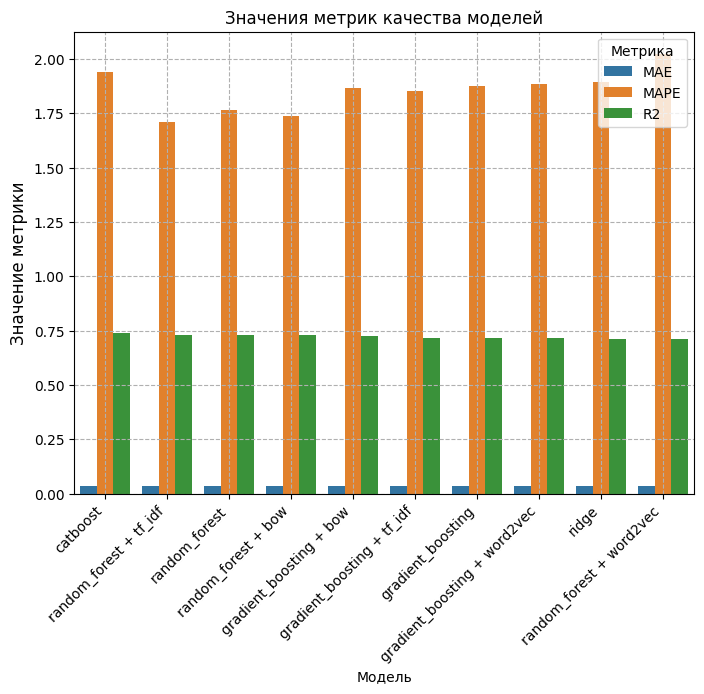

In [ ]:
metrics = {
    'Model': ['ridge', 'random_forest + bow', 'gradient_boosting + bow', 'random_forest + tf_idf', 'gradient_boosting + tf_idf',
              'random_forest + word2vec', 'gradient_boosting + word2vec', 'random_forest', 'gradient_boosting', 'catboost'],
    'MAE': [0.036, 0.034, 0.035, 0.034, 0.036, 0.037, 0.037, 0.034, 0.037, 0.034],
    'MAPE': [1.892,  1.736, 1.867, 1.708, 1.853, 2.023, 1.882, 1.763, 1.877, 1.937],
    'R2': [0.713, 0.729, 0.726, 0.731, 0.717, 0.71, 0.715, 0.73, 0.715, 0.741]
}

df = pd.DataFrame(metrics)

df = df.sort_values(by='R2', ascending=False)

long_df = df.melt(id_vars='Model', var_name='Metric', value_name='Value')

plt.figure(figsize=(8, 6))
sns.barplot(data=long_df, x='Model', y='Value', hue='Metric')

plt.title('Значения метрик качества моделей')
plt.xlabel('Модель')
plt.ylabel('Значение метрики', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.legend(title='Метрика')
plt.grid(linestyle='--')

plt.show()

### __Результаты моделей и подходов__

Лучшие замеры моделей на валидационной выборке:
1. Гребневая регрессия (alpha=5)    

mae = 0.036  
mape = 1.892  
r2 = 0.713  

2. Случайный лес (n_estimators=100, max_depth=None, min_samples_split=2, min_samples_leaf=1, max_features='sqrt') + BoW (мешок слов)   

mae = 0.034  
mape = 1.736  
r2 = 0.729  

3. Градиентный бустинг (learning_rate=0.05, max_depth=7, min_samples_split=5, n_estimators=300) + BoW (мешок слов)   

mae = 0.035  
mape = 1.867  
r2 = 0.726  

4. Случайный лес (n_estimators=100, max_depth=None, min_samples_split=2, min_samples_leaf=1, max_features='sqrt') + TF-IDF  

mae = 0.034  
mape = 1.708  
r2 = 0.731  

5. Градиентный бустинг (learning_rate=0.05, max_depth=7, min_samples_split=5, n_estimators=300) + TF-IDF  

mae = 0.036  
mape = 1.853  
r2 = 0.717  

6. Случайный лес (n_estimators=100, max_depth=None, min_samples_split=2, min_samples_leaf=1, max_features='sqrt') + word2vec (vector_size=100 (размер векторного представления слов), window=5 (сколько учитываем слов), min_count=1 (учитваем все слова, даже редкие))  

mae = 0.036  
mape = 2.023  
r2 = 0.71  

7. Градиентный бустинг (learning_rate=0.05, max_depth=7, min_samples_split=5, n_estimators=300) + word2vec (vector_size=100 (размер векторного представления слов), window=5 (сколько учитываем слов), min_count=1 (учитваем все слова, даже редкие))  

mae = 0.037  
mape = 1.882  
r2 = 0.715  

8. Случайный лес (n_estimators=100, max_depth=None, min_samples_split=2, min_samples_leaf=1, max_features='sqrt')  

mae = 0.034  
mape = 1.763  
r2 = 0.73  

9. Градиентный бустинг (learning_rate=0.05, max_depth=7, min_samples_split=5, n_estimators=300)  

mae = 0.037  
mape = 1.877  
r2 = 0.715  

10. Catboost (n_estimators=1000, max_depth=6, learning_rate=0.03)  

mae = 0.034  
mape = 1.937    
r2 = 0.741  


__Сравнение моделей:__   
В рамках работы были протестированы различные алгоритмы машинного обучения (линейные модели, ансамбли деревьев и градиентный бустинг), а также подходы к векторизации текстового признака (address_rus): BoW, TF-IDF и Word2Vec.

Наилучшие метрики на валидационной выборке показали:  
- CatBoost (n_estimators=1000, max_depth=6, learning_rate=0.03):   
MAE = 0.034, MAPE = 1.937, R² = 0.741 — лучший __R²__ среди всех моделей;   

- RandomForest + TF-IDF:  
MAE = 0.034, MAPE = 1.708, R² = 0.731 — наименьшая ошибка MAPE.

__Основные выводы:__
- Векторизация текста влияет на качество, особенно при использовании TF-IDF (лучшее соотношение MAE и MAPE);
- Word2Vec показал менее стабильные результаты на текущем объёме и контексте данных, вероятно, из-за недостатка текстовой информации или специфики токенов адресов;
- Простая гребневая регрессия дала достойный результат, но лучшей модели по совокупности метрик качества оказался CatBoost.



## Часть 5 | Применение моделей глубинного обучения (DL)

In [82]:
import torch
from torch import nn
from tqdm.notebook import tqdm
from IPython.display import clear_output
import copy
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler

Воспользуемся ниженаписанной функцией из домашней работы по глубинному обучению. Данная функция обучает и валидирует модель в течении заданного числа эпох и отслеживает лучшее значение метрики. Она также строит графики для отслеживания лосса и метрики во время обучения модели.




In [83]:
def plot_losses(train_losses, train_metrics, val_losses, val_metrics):
    """
    Plot losses and metrics while training
      - train_losses: sequence of train losses
      - train_metrics: sequence of train MSE values
      - val_losses: sequence of validation losses
      - val_metrics: sequence of validation MSE values
    """
    clear_output()
    fig, axs = plt.subplots(1, 2, figsize=(15, 5))
    axs[0].plot(range(1, len(train_losses) + 1), train_losses, label="train")
    axs[0].plot(range(1, len(val_losses) + 1), val_losses, label="val")
    axs[1].plot(range(1, len(train_metrics) + 1), train_metrics, label="train")
    axs[1].plot(range(1, len(val_metrics) + 1), val_metrics, label="val")

    if max(train_losses) / min(train_losses) > 10:
        axs[0].set_yscale("log")

    if max(train_metrics) / min(train_metrics) > 10:
        axs[0].set_yscale("log")

    for ax in axs:
        ax.set_xlabel("epoch")
        ax.legend()

    axs[0].set_ylabel("loss")
    axs[1].set_ylabel("MSE")
    plt.show()


def train_and_validate(
    model,
    optimizer,
    criterion,
    metric,
    train_loader,
    val_loader,
    num_epochs,
    verbose=True,
):
    train_losses, val_losses = [], []
    train_metrics, val_metrics = [], []

    best_val_metric = float("inf")
    best_epoch = 0
    best_model_state = None  # для хранения лучших весов

    for epoch in range(1, num_epochs + 1):
        model.train()
        running_loss, running_metric = 0, 0
        pbar = tqdm(train_loader, desc=f"Training {epoch}/{num_epochs}") if verbose else train_loader

        for i, (X_batch, y_batch) in enumerate(pbar, 1):
            X_batch = X_batch.to(device)
            y_batch = y_batch.to(device)
            predictions = model(X_batch)
            loss = criterion(predictions, y_batch)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            with torch.no_grad():
                metric_value = metric(predictions, y_batch)
                if isinstance(metric_value, torch.Tensor):
                    metric_value = metric_value.item()
                running_loss += loss.item() * X_batch.shape[0]
                running_metric += metric_value * X_batch.shape[0]

        train_losses.append(running_loss / len(train_loader.dataset))
        train_metrics.append(running_metric / len(train_loader.dataset))

        model.eval()
        running_loss, running_metric = 0, 0
        pbar = tqdm(val_loader, desc=f"Validating {epoch}/{num_epochs}") if verbose else val_loader

        for i, (X_batch, y_batch) in enumerate(pbar, 1):
            X_batch = X_batch.to(device)
            y_batch = y_batch.to(device)
            with torch.no_grad():
                predictions = model(X_batch)
                loss = criterion(predictions, y_batch)
                metric_value = metric(predictions, y_batch)
                if isinstance(metric_value, torch.Tensor):
                    metric_value = metric_value.item()
                running_loss += loss.item() * X_batch.shape[0]
                running_metric += metric_value * X_batch.shape[0]

        val_losses.append(running_loss / len(val_loader.dataset))
        val_metrics.append(running_metric / len(val_loader.dataset))

        # Обновляем лучшее значение и сохраняем веса модели
        if val_metrics[-1] < best_val_metric:
            best_val_metric = val_metrics[-1]
            best_epoch = epoch
            best_model_state = copy.deepcopy(model.state_dict())

        scheduler.step(val_losses[-1])

        if verbose:
            plot_losses(train_losses, train_metrics, val_losses, val_metrics)

    # Загружаем лучшие веса модели
    if best_model_state is not None:
        model.load_state_dict(best_model_state)

    if verbose:
        print(f"Best Validation MSE: {best_val_metric:.3f} at epoch {best_epoch}")

    return train_metrics[-1], val_metrics[-1], best_val_metric, best_epoch

Отберем колонки для дальнейшей работы:

In [84]:
cols_for_fit = ['atm_group', 'lat', 'long', 'postal_code', 'settlement', 'street_name', 'settlement_count', 'p', 'target', 'number']

In [85]:
df_train_filtered = df_train_filtered[cols_for_fit]

In [86]:
df_train_filtered.dtypes

,0
atm_group,object
lat,float64
long,float64
postal_code,object
settlement,object
street_name,object
settlement_count,float64
p,float64
target,float64
number,object


In [87]:
df_train_filtered.isna().sum()

,0
atm_group,0
lat,0
long,0
postal_code,1259
settlement,16
street_name,157
settlement_count,0
p,16
target,0
number,199


In [88]:
df_train_for_fit = df_train_filtered.copy()

In [89]:
df_train_for_fit['atm_group'] = df_train_for_fit['atm_group'].astype(str)

Отбработаем пропуски в наших данных:

In [91]:
df_train_for_fit['p'].fillna(df_train_for_fit['p'].median(), inplace=True)
df_train_for_fit['street_name'].fillna('999', inplace=True)
df_train_for_fit['settlement'].fillna('222', inplace=True)
df_train_for_fit['postal_code'].fillna('-999', inplace=True)
df_train_for_fit['number'].fillna('333', inplace=True)

<ipython-input-91-ebef3ea4ef9c>:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_train_for_fit['p'].fillna(df_train_for_fit['p'].median(), inplace=True)


In [92]:
df_train_for_fit

,atm_group,lat,long,postal_code,settlement,street_name,settlement_count,p,target,number
0,32.0,46.94,142.74,-999,Южно-Сахалинск,А.О. Емельянова,28.00,0.02,0.01,34
1,32.0,46.94,142.75,-999,Комсомольск,Комсомольская,66.00,0.03,0.03,259
2,32.0,46.96,142.74,-999,Южно-Сахалинск,Коммунистический проспект,28.00,0.02,0.01,333
3,32.0,55.81,37.52,125315,Москва,Ленинградский проспект,504.00,0.03,-0.09,76А
4,32.0,69.34,88.21,663302,Гвардейск,Гвардейская площадь,5.00,0.00,0.08,2
...,...,...,...,...,...,...,...,...,...,...
6256,8083.0,62.05,129.75,677009,Якутск,Федора Попова,65.00,0.02,0.21,14
6257,8083.0,53.77,87.12,654005,Новокузнецк,проспект Строителей,32.00,-0.01,0.06,43
6258,8083.0,55.77,37.38,121609,Москва,Рублёвское шоссе,504.00,0.03,0.11,62
6259,8083.0,56.84,86.64,-999,Томск,Ефанова,85.00,0.03,0.15,22


Поделим данные на категориальные и числовые признаки:

In [93]:
cat_features = ['atm_group', 'settlement', 'street_name', 'postal_code', 'number']
num_features = ['lat', 'long', 'settlement_count', 'p']

Создадим пайплайн предобработки:
- числовые признаки стандартизируем с помощью StandardScaler;
- категориальные преобразуем через one OneHotEncoder.


In [94]:
preprocessor = ColumnTransformer(transformers=[('num', StandardScaler(), num_features),
                                               ('cat', OneHotEncoder(handle_unknown='ignore'), cat_features)])

In [95]:
features = cat_features + num_features
target = 'target'

Выделим признаки и целевую переменную:

In [96]:
X = df_train_for_fit[features]
y = df_train_for_fit[target]

Разделим данные на тренировочную и валидационную выборки:

In [102]:
X_train_df, X_val_df, y_train_df, y_val_df = train_test_split(X, y, test_size=0.3, random_state=RANDOM_STATE)

Преобразуем наши данные:

In [103]:
X_train_scaled = preprocessor.fit_transform(X_train_df)
X_val_scaled = preprocessor.transform(X_val_df)

Преобразуем данные в тензоры:

In [104]:
X_train_tensor = torch.tensor(X_train_scaled.toarray(), dtype=torch.float32)
y_train_tensor = torch.tensor(y_train_df.values, dtype=torch.float32).view(-1, 1)

X_val_tensor = torch.tensor(X_val_scaled.toarray(), dtype=torch.float32)
y_val_tensor = torch.tensor(y_val_df.values, dtype=torch.float32).view(-1, 1)

Обернем наши данные в датасеты для pytorch:

In [105]:
train_dataset = torch.utils.data.TensorDataset(X_train_tensor, y_train_tensor)
val_dataset = torch.utils.data.TensorDataset(X_val_tensor, y_val_tensor)

Создадим загрузчик с батчами заданного размера:

In [106]:
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=64)

1) Испробуем в качестве первой нейросети - полносвязную нейросеть для задачи регрессии. Она состоит из трех полносвязных слоев с функциями активации ReLU и нормализацией признаков после первого слоя:  

In [107]:
class Netmodel(nn.Module):
    def __init__(self, input_dim):
        super(Netmodel, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 1)
        )

    def forward(self, x):
        return self.net(x)

Объявим модель:

In [108]:
model = Netmodel(input_dim=X_train_scaled.shape[1])

In [109]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

Netmodel(
  (net): Sequential(
    (0): Linear(in_features=4237, out_features=128, bias=True)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Linear(in_features=128, out_features=64, bias=True)
    (4): ReLU()
    (5): Linear(in_features=64, out_features=1, bias=True)
  )
)

Определим лосс (MSE), оптимизатор (Adam, learning_rate=1e-3) и метрику (MSE):

In [110]:
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

In [111]:
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

Запустим обучение на 20 эпохах:

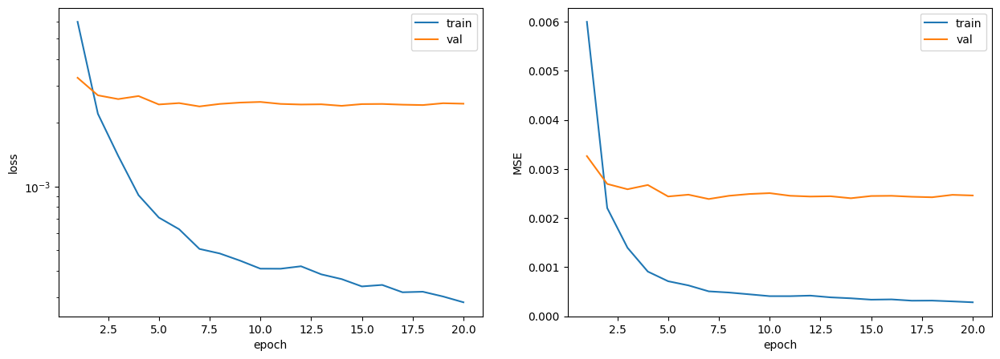

Best Validation MSE: 0.002 at epoch 7


(0.0002831982731679309, 0.002460675571380512, 0.0023883567874005245, 7)

In [112]:
train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=20,
    verbose=True
)

In [118]:
y_val = y_val_df.values

Посмотрим на качество:

In [119]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0386
MAPE: 1.9169
R²: 0.6785


2) Попробуем добавить к прошлой модели dropout регуляризацию:

In [ ]:
class Netmodel_1(nn.Module):
    def __init__(self, input_dim):
        super(Netmodel_1, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 1)
        )

    def forward(self, x):
        return self.net(x)

In [ ]:
model = Netmodel_1(input_dim=X_train_scaled.shape[1])

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

Netmodel_1(
  (net): Sequential(
    (0): Linear(in_features=4237, out_features=128, bias=True)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout(p=0.3, inplace=False)
    (4): Linear(in_features=128, out_features=64, bias=True)
    (5): ReLU()
    (6): Linear(in_features=64, out_features=1, bias=True)
  )
)

In [ ]:
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

In [ ]:
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

Запустим обучение на 20 эпохах:

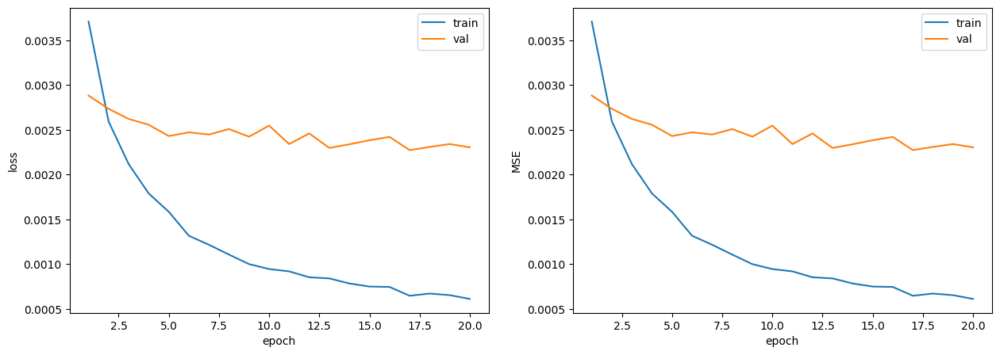

Best Validation MSE: 0.002 at epoch 17


(0.0006126041948027073, 0.0023050160648330413, 0.002274456504790708, 17)

In [ ]:
train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=20,
    verbose=True
)

Снова замерим качество:

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0372
MAPE: 2.0983
R²: 0.6939


In [ ]:
model = Netmodel_1(input_dim=X_train_scaled.shape[1])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

Попробуем запустить обучение на чуть большем числе эпох - 50:

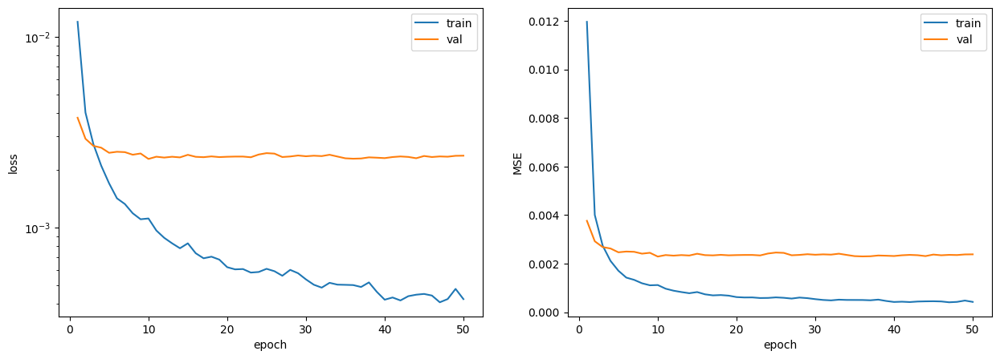

Best Validation MSE: 0.002 at epoch 10


(0.00042271793298873426, 0.002382227747286493, 0.002290333880599113, 10)

In [ ]:
train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=50,
    verbose=True
)

Замерим качество:

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0379
MAPE: 2.0599
R²: 0.6917


Попробуем увеличить градиентный шаг:

In [ ]:
model = Netmodel_1(input_dim=X_train_scaled.shape[1])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-2)
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

Запустим обучение на 50 эпохах:

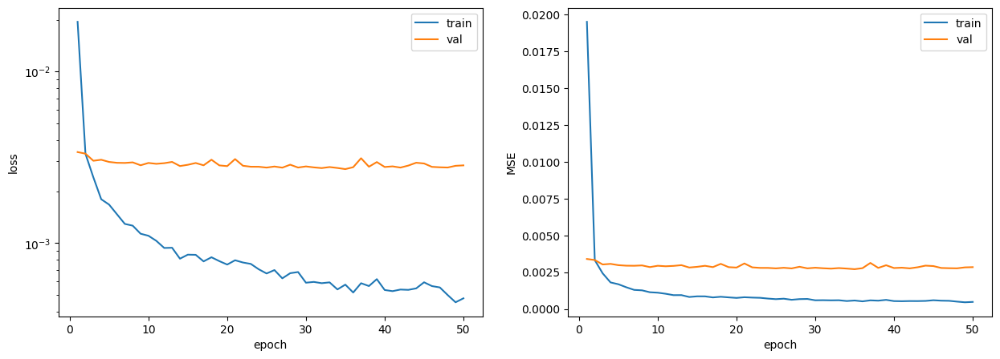

Best Validation MSE: 0.003 at epoch 35


(0.00047699289974600386, 0.0028418922474945352, 0.0027023869409315473, 35)

In [ ]:
train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=50,
    verbose=True
)

Замерим качество:

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0401
MAPE: 1.9750
R²: 0.6363


Попробуем теперь уменьшить градиентный шаг до 1е-4.  
Запустим обучение на 50 эпохах:

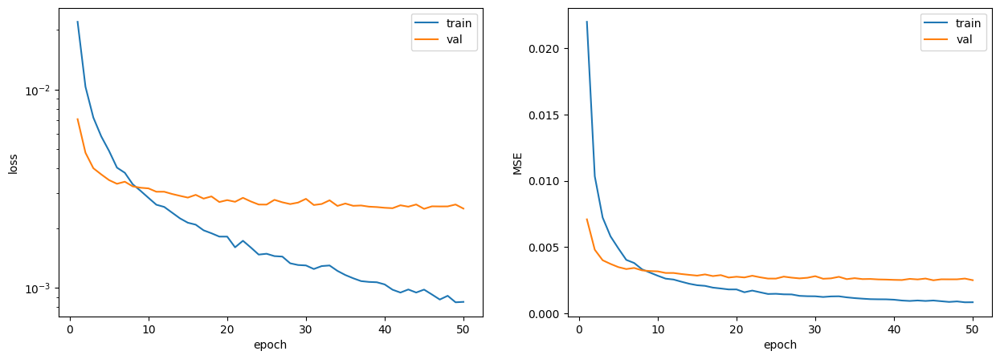

Best Validation MSE: 0.003 at epoch 45


(0.000850519252910631, 0.0025131618734282467, 0.002505743438565491, 45)

In [ ]:
model = Netmodel_1(input_dim=X_train_scaled.shape[1])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=50,
    verbose=True
)

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0395
MAPE: 2.2658
R²: 0.6627


3) Давайте снова усложним модель - добавим еще один скрытый слой:

In [ ]:
class Netmodel_2(nn.Module):
    def __init__(self, input_dim):
        super(Netmodel_2, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 32),   # Новый слой
            nn.ReLU(),
            nn.Linear(32, 1)
        )

    def forward(self, x):
        return self.net(x)

Запустим обучение на 50 эпохах:

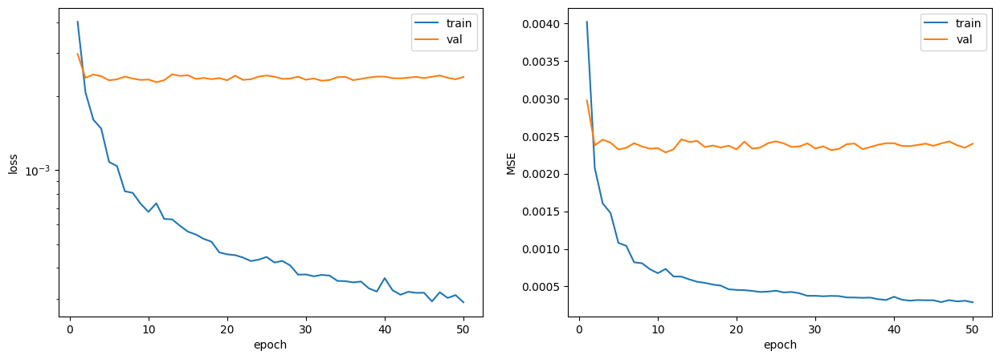

Best Validation MSE: 0.002 at epoch 11


(0.0002899199746145683, 0.0023972761605801666, 0.0022815927431837422, 11)

In [ ]:
model = Netmodel_2(input_dim=X_train_scaled.shape[1])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=50,
    verbose=True
)

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0372
MAPE: 2.1308
R²: 0.6929


4) Попробуем уменьшить значение Dropout до 0.2:

In [ ]:
class Netmodel_3(nn.Module):
    def __init__(self, input_dim):
        super(Netmodel_3, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.2),  # уменьшили значение dropout
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )

    def forward(self, x):
        return self.net(x)

Попробуем использовать weight_decay=1e-4 для регуляризации весов:

In [ ]:
model = Netmodel_3(input_dim=X_train_scaled.shape[1])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-4)
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

Запустим обучение на 50 эпохах:

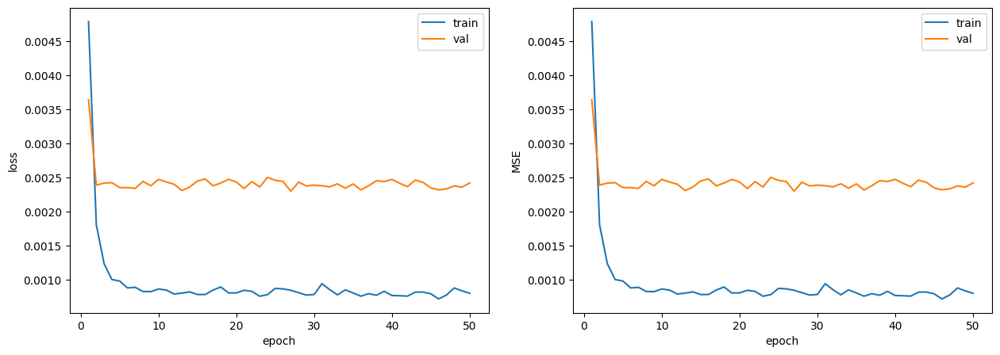

Best Validation MSE: 0.002 at epoch 27


(0.0007987700233070198, 0.0024198702400054376, 0.0022980914757455757, 27)

In [ ]:
train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=50,
    verbose=True
)

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0372
MAPE: 1.9197
R²: 0.6907


5) Попробуем применить lr_scheduler.ReduceLROnPlateau - метод, который уменьшает скорость обучения, когда указанный параметр перестаёт улучшаться в течение определённого количества эпох:

In [ ]:
class Netmodel_52(nn.Module):
    def __init__(self, input_dim):
        super(Netmodel_52, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )

    def forward(self, x):
        return self.net(x)

In [ ]:
model = Netmodel_52(input_dim=X_train_scaled.shape[1])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.MSELoss()
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer)

Запустим обучение на 50 эпохах:

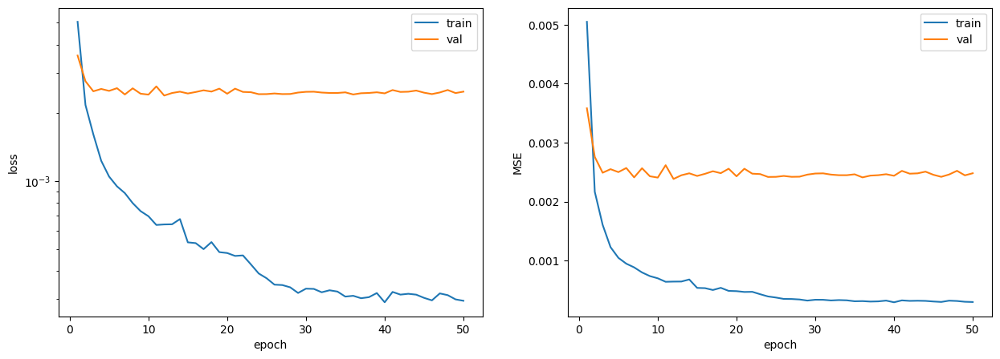

Best Validation MSE: 0.002 at epoch 12


(0.0002948410786309901, 0.0024803383979046306, 0.0023835156528566707, 12)

In [ ]:
train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=50,
    verbose=True
)

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0379
MAPE: 1.9739
R²: 0.6792


6) Попробуем добавить нормализацию признаков после каждого линейного слоя:

In [ ]:
class Netmodel_53(nn.Module):
    def __init__(self, input_dim):
        super(Netmodel_53, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(128, 64),
            nn.BatchNorm1d(64),         #
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.BatchNorm1d(32),         #
            nn.ReLU(),
            nn.Linear(32, 1)
        )

    def forward(self, x):
        return self.net(x)

Попробуем снова добавить weight_decay=1e-4:

In [ ]:
model = Netmodel_52(input_dim=X_train_scaled.shape[1])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-4)
criterion = nn.MSELoss()
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer)

Запустим обучение теперь на 75 эпохах:

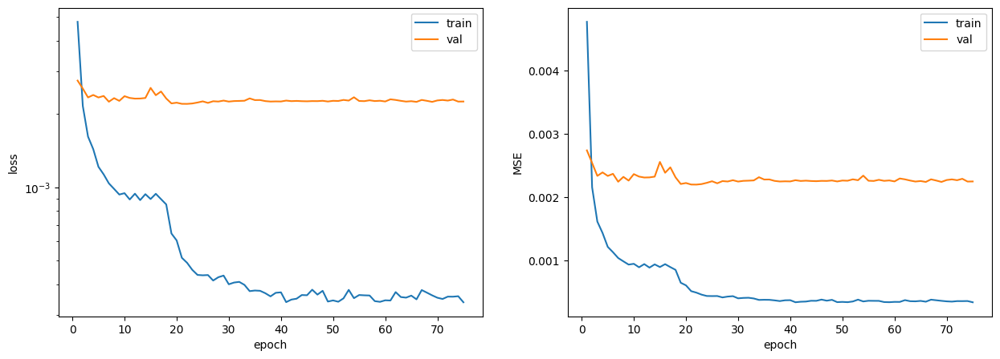

Best Validation MSE: 0.002 at epoch 22


(0.0003375358919343987, 0.0022487668466381313, 0.002199110226034785, 22)

In [ ]:
train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=75,
    verbose=True
)

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0363
MAPE: 2.0304
R²: 0.7040


Это пока лучшее качество, которое удалось выбить.

7) Увеличим число нейронов в слоях:

In [ ]:
class Netmodel_6(nn.Module):
    def __init__(self, input_dim):
        super(Netmodel_6, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 1)
        )

    def forward(self, x):
        return self.net(x)

In [ ]:
model = Netmodel_6(input_dim=X_train_scaled.shape[1])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.MSELoss()
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer)

Запустим обучение на 75 эпохах:

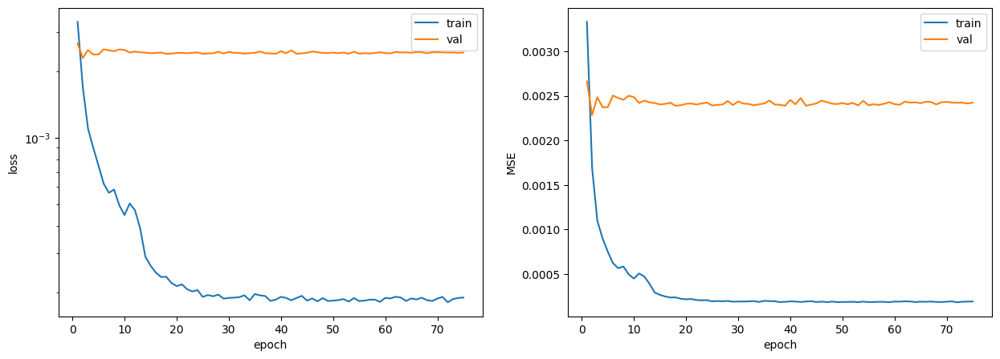

Best Validation MSE: 0.002 at epoch 2


(0.0001897502193547643, 0.0024243540774355797, 0.0022860273882388334, 2)

In [ ]:
train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=75,
    verbose=True
)

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0377
MAPE: 2.2107
R²: 0.6923


8) Попробуем поменять функцию активации ReLU на LeakyReLU:

In [ ]:
class Netmodel_7(nn.Module):
    def __init__(self, input_dim):
        super(Netmodel_7, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 512),
            nn.BatchNorm1d(512),
            nn.LeakyReLU(0.01),
            nn.Dropout(0.3),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.01),
            nn.Linear(256, 128),
            nn.LeakyReLU(0.01),
            nn.Linear(128, 64),
            nn.LeakyReLU(0.01),
            nn.Linear(64, 1)
        )

    def forward(self, x):
        return self.net(x)

In [ ]:
model = Netmodel_7(input_dim=X_train_scaled.shape[1])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.MSELoss()
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer)

Запустим обучение на 75 эпохах:

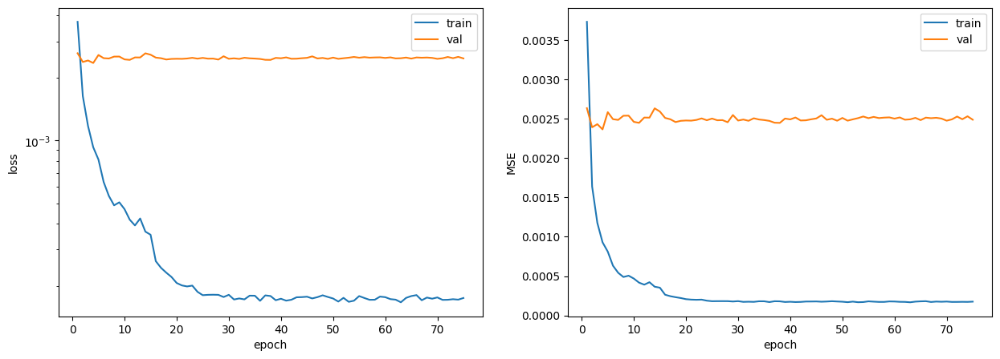

Best Validation MSE: 0.002 at epoch 4


(0.0001747648648685319, 0.0024877776078238117, 0.0023647354820939053, 4)

In [ ]:
train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=75,
    verbose=True
)

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0380
MAPE: 2.1394
R²: 0.6817


9) Добавим еще слой и увеличим число нейронов:

In [ ]:
class Netmodel_8(nn.Module):
    def __init__(self, input_dim):
        super(Netmodel_8, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 1024),
            nn.BatchNorm1d(1024),
            nn.LeakyReLU(0.01),
            nn.Dropout(0.3),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.01),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.01),
            nn.Dropout(0.3),
            nn.Linear(256, 128),
            nn.LeakyReLU(0.01),
            nn.Linear(128, 64),
            nn.LeakyReLU(0.01),
            nn.Dropout(0.3),
            nn.Linear(64, 1)
        )

    def forward(self, x):
        return self.net(x)

In [ ]:
model = Netmodel_8(input_dim=X_train_scaled.shape[1])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.MSELoss()
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer)

Запустим обучение на 75 эпохах:

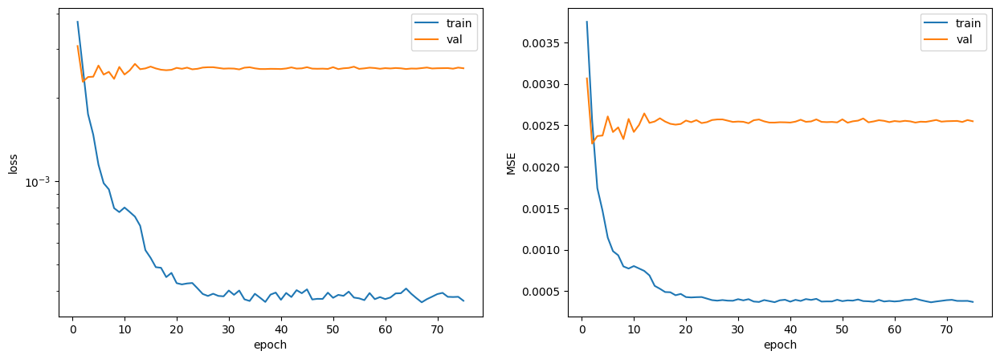

Best Validation MSE: 0.002 at epoch 2


(0.00036975493015343683, 0.002548021869629755, 0.0022785889632766544, 2)

In [ ]:
train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=75,
    verbose=True
)

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0381
MAPE: 1.8865
R²: 0.6933


10) Попробуем уменьшить значение dropout:

In [ ]:
class Netmodel_9(nn.Module):
    def __init__(self, input_dim):
        super(Netmodel_9, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 1024),
            nn.BatchNorm1d(1024),
            nn.LeakyReLU(0.01),
            nn.Dropout(0.2),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.01),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.01),
            nn.Dropout(0.2),
            nn.Linear(256, 128),
            nn.LeakyReLU(0.01),
            nn.Linear(128, 64),
            nn.LeakyReLU(0.01),
            nn.Dropout(0.2),
            nn.Linear(64, 1)
        )

    def forward(self, x):
        return self.net(x)

In [ ]:
model = Netmodel_9(input_dim=X_train_scaled.shape[1])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
criterion = nn.MSELoss()
metric = lambda outputs, targets: ((outputs - targets) ** 2).mean()

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer)

Увелимим число эпох до 200:

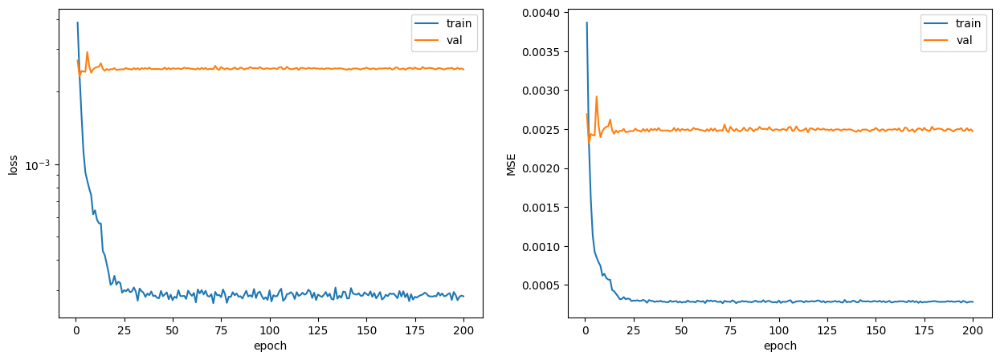

Best Validation MSE: 0.002 at epoch 2


(0.00028279166933289614, 0.0024727958913942512, 0.0023145995699744297, 2)

In [ ]:
train_and_validate(
    model=model,
    optimizer=optimizer,
    criterion=criterion,
    metric=metric,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=200,
    verbose=True
)

In [ ]:
model.eval()  # Переводим модель в режим оценки
with torch.no_grad():
    y_val_pred = model(X_val_tensor.to(device)).cpu().numpy()

mae = MAE(y_val, y_val_pred)
mape = MAPE(y_val, y_val_pred)
r2 = R2(y_val, y_val_pred)

print(f"MAE: {mae:.4f}")
print(f"MAPE: {mape:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0380
MAPE: 2.2786
R²: 0.6885


## __Отчет 2 по проделанной работе:__

В ходе большого числа экспериментов удалось выбить на модели Netmodel_52 с несколькими полносвязными слоями, батч нормализацией, функцией активации ReLU и dropout следующее значение метрик:

mae = 0.0363  
mape = 2.0304  
r2 = 0.7040  

__Основные выводы:__  
На текущей модели не удалось выбить качество, превосходящее CatBoost. Возможно причина в недостаточном объеме ланных, чтобы не переобучаться, научиться лучше обощать наши данные, выучить сложные зависимости. Тем не менее с данной моделью удалось добиться удовлетворительных результатов, что подтверждает ее способность выявлять основные закономерности в данных.